<a href="https://colab.research.google.com/github/tantandar02/metbuoy-data-analysis/blob/main/DO_PH_AMM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## ACQUIRING THE DATA

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import seaborn as sns
import plotly.express as px

from mpl_toolkits.mplot3d import Axes3D

In [ ]:
url = "https://drive.google.com/uc?id=1p-9l9z4ONI0QQZlCVRvcEJyEcsQXjcAN"
df = pd.read_csv(url).drop(columns=["WATER TURBIDITY (NTU)", "SPECIFIC CONDUCTIVITY (mS/cm)", "CHLOROPHYL (ug/L)"])

df['DATE/TIME READ'] = pd.to_datetime(df['DATE/TIME READ'], errors="coerce")

start = "2024-10-04 0:01:08"
end = "2025-08-12 19:30:00"

df6m = df.loc[(df["DATE/TIME READ"] >= start) & (df["DATE/TIME READ"] <= end)].copy()

num_cols = df6m.columns.drop("DATE/TIME READ")
df6m[num_cols] = df6m[num_cols].apply(pd.to_numeric, errors="coerce")

df6m.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15522 entries, 14743 to 30264
Data columns (total 16 columns):
 #   Column                                 Non-Null Count  Dtype         
---  ------                                 --------------  -----         
 0   DATE/TIME READ                         15522 non-null  datetime64[ns]
 1   AIR TEMPERATURE (°C)                   15368 non-null  float64       
 2   AIR PRESSURE (hPa)                     15368 non-null  float64       
 3   WIND SPEED (kph)                       15369 non-null  float64       
 4   WIND ANGLE (Degrees C)                 15370 non-null  float64       
 5   WATER TEMPERATURE (Degrees C)          15472 non-null  float64       
 6   WATER SALINITY (PSU)                   15472 non-null  float64       
 7   TOTAL DISSOLVED SOLIDS (g/L)           15472 non-null  float64       
 8   RAW CONDUCTIVITY (uS/cm)               15472 non-null  float64       
 9   DISSOLVED OXYGEN (mg/L)                15472 non-null  float64

In [ ]:
df6m.head()

,DATE/TIME READ,AIR TEMPERATURE (°C),AIR PRESSURE (hPa),WIND SPEED (kph),WIND ANGLE (Degrees C),WATER TEMPERATURE (Degrees C),WATER SALINITY (PSU),TOTAL DISSOLVED SOLIDS (g/L),RAW CONDUCTIVITY (uS/cm),DISSOLVED OXYGEN (mg/L),DISSOLVED OXYGEN SATURATION (%),WATER PRESSURE (),PH VALUE (pH),AMMONIUM (mg/L),OXIDATION REDUCTION POTENTIAL (Torr),OXYGEN PARTIAL PRESSURE ()
14743,2024-10-04 00:01:08,26.0,1010.1,0.7,197.8,30.48,0.89,1.14,1.9295,9.89,131.9,779.2,9.49,3.65,102.0,200.89
14744,2024-10-04 00:30:57,25.9,1010.0,0.8,125.3,30.43,0.88,1.12,1.8936,9.66,128.7,778.9,9.47,3.57,106.3,196.15
14745,2024-10-04 01:00:59,25.7,1009.8,4.1,243.2,30.44,1.00,1.26,2.1441,9.63,128.4,778.9,9.47,3.48,109.0,195.56
14746,2024-10-04 01:31:01,25.6,1009.6,2.2,206.6,30.45,0.90,1.14,1.9414,9.42,125.6,778.3,9.46,3.51,109.1,191.34
14747,2024-10-04 02:01:01,25.2,1009.2,3.1,227.9,30.43,0.91,1.15,1.9570,9.37,124.9,778.3,9.45,3.32,109.2,190.28


#### Plot Original Data

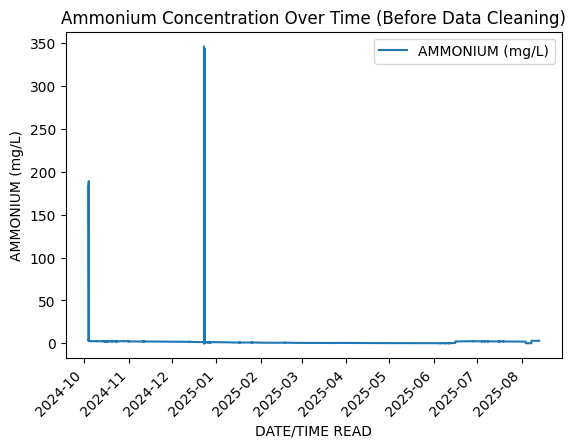

In [ ]:
df6m.plot(x="DATE/TIME READ", y="AMMONIUM (mg/L)")
plt.title("Ammonium Concentration Over Time (Before Data Cleaning)")
plt.ylabel("AMMONIUM (mg/L)")
plt.xticks(rotation=45)
plt.show()

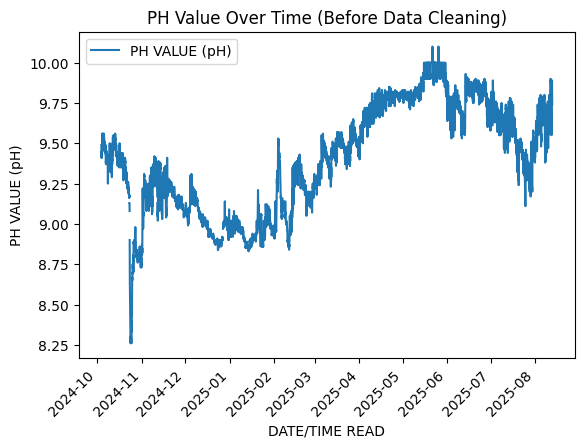

In [ ]:
df6m.plot(x="DATE/TIME READ", y="PH VALUE (pH)")
plt.title("PH Value Over Time (Before Data Cleaning)")
plt.ylabel("PH VALUE (pH)")
plt.xticks(rotation=45)
plt.show()

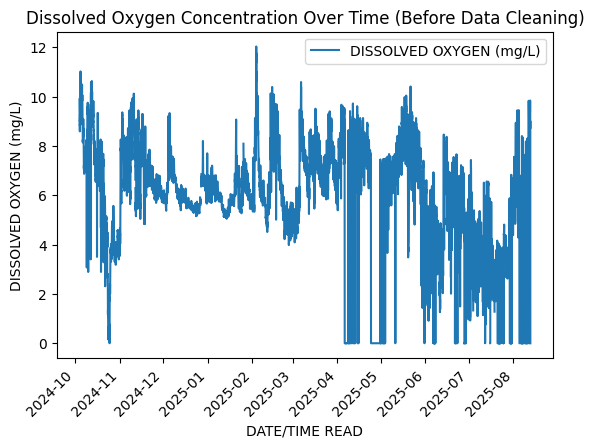

In [ ]:
df6m.plot(x="DATE/TIME READ", y="DISSOLVED OXYGEN (mg/L)")
plt.title("Dissolved Oxygen Concentration Over Time (Before Data Cleaning)")
plt.ylabel("DISSOLVED OXYGEN (mg/L)")
plt.xticks(rotation=45)
plt.show()

## HANDLING MISSING VALUES

In [ ]:
df6m = df6m.dropna(subset=["DATE/TIME READ"]).sort_values("DATE/TIME READ").reset_index(drop=True)

In [ ]:
df6m.index.shape[0]

15522

In [ ]:
cols_needed = ["DATE/TIME READ", "DISSOLVED OXYGEN (mg/L)", "PH VALUE (pH)", "AMMONIUM (mg/L)"]

new_df = df6m[[c for c in cols_needed if c in df6m.columns]].copy()
new_df.head()

,DATE/TIME READ,DISSOLVED OXYGEN (mg/L),PH VALUE (pH),AMMONIUM (mg/L)
0,2024-10-04 00:01:08,9.89,9.49,3.65
1,2024-10-04 00:30:57,9.66,9.47,3.57
2,2024-10-04 01:00:59,9.63,9.47,3.48
3,2024-10-04 01:31:01,9.42,9.46,3.51
4,2024-10-04 02:01:01,9.37,9.45,3.32


In [ ]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15522 entries, 0 to 15521
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   DATE/TIME READ           15522 non-null  datetime64[ns]
 1   DISSOLVED OXYGEN (mg/L)  15472 non-null  float64       
 2   PH VALUE (pH)            15463 non-null  float64       
 3   AMMONIUM (mg/L)          15415 non-null  float64       
dtypes: datetime64[ns](1), float64(3)
memory usage: 485.2 KB


In [ ]:
# create a "day only" column which will be set as index
new_df["DAY"] = new_df["DATE/TIME READ"].dt.date

# get the total count of rows for each day
total_rows_df = new_df.groupby("DAY")[["DISSOLVED OXYGEN (mg/L)", "PH VALUE (pH)", "AMMONIUM (mg/L)"]].size().rename("total_rows")

# get the total count of missing values in DO column for each day
nan_do_df = new_df.groupby("DAY")["DISSOLVED OXYGEN (mg/L)"].apply(lambda s: s.isna().sum()).rename("nan_do")

# get the total count of missing values in pH column for each day
nan_ph_df = new_df.groupby("DAY")["PH VALUE (pH)"].apply(lambda s: s.isna().sum()).rename("nan_ph")

# get the total count of missing values in Ammonium column for each day
nan_ammo_df = new_df.groupby("DAY")["AMMONIUM (mg/L)"].apply(lambda s: s.isna().sum()).rename("nan_ammo")

# create a dataframe combining all columns and bring the date back
audit = pd.concat([total_rows_df, nan_do_df, nan_ph_df, nan_ammo_df], axis=1).reset_index()
audit.head()

,DAY,total_rows,nan_do,nan_ph,nan_ammo
0,2024-10-04,64,2,11,2
1,2024-10-05,48,0,0,0
2,2024-10-06,48,0,0,0
3,2024-10-07,48,0,0,0
4,2024-10-08,48,0,0,0


In [ ]:
audit['nan_do_%'] = (audit['nan_do'] / audit["total_rows"]).round(2)
audit["nan_ph_%"] = (audit["nan_ph"] / audit["total_rows"]).round(2)
audit["nan_ammo_%"] = (audit["nan_ammo"] / audit["total_rows"]).round(2)
audit["keep_day"] = (audit["nan_do_%"] < 0.20) & (audit["nan_ph_%"] < 0.20) & (audit["nan_ammo_%"] < 0.20)
audit.head()

,DAY,total_rows,nan_do,nan_ph,nan_ammo,nan_do_%,nan_ph_%,nan_ammo_%,keep_day
0,2024-10-04,64,2,11,2,0.03,0.17,0.03,True
1,2024-10-05,48,0,0,0,0.00,0.00,0.00,True
2,2024-10-06,48,0,0,0,0.00,0.00,0.00,True
3,2024-10-07,48,0,0,0,0.00,0.00,0.00,True
4,2024-10-08,48,0,0,0,0.00,0.00,0.00,True


In [ ]:
audit.loc[audit["keep_day"] == False, audit.columns]

,DAY,total_rows,nan_do,nan_ph,nan_ammo,nan_do_%,nan_ph_%,nan_ammo_%,keep_day
20,2024-10-24,48,0,0,43,0.00,0.00,0.90,False
82,2024-12-25,38,10,10,10,0.26,0.26,0.26,False


In [ ]:
kept_days = set(audit.loc[audit["keep_day"], "DAY"])
df_keep = new_df[new_df["DAY"].isin(kept_days)].copy()
df_keep.head()

,DATE/TIME READ,DISSOLVED OXYGEN (mg/L),PH VALUE (pH),AMMONIUM (mg/L),DAY
0,2024-10-04 00:01:08,9.89,9.49,3.65,2024-10-04
1,2024-10-04 00:30:57,9.66,9.47,3.57,2024-10-04
2,2024-10-04 01:00:59,9.63,9.47,3.48,2024-10-04
3,2024-10-04 01:31:01,9.42,9.46,3.51,2024-10-04
4,2024-10-04 02:01:01,9.37,9.45,3.32,2024-10-04


In [ ]:
df_drop = new_df[~new_df["DAY"].isin(kept_days)].copy()
df_drop

,DATE/TIME READ,DISSOLVED OXYGEN (mg/L),PH VALUE (pH),AMMONIUM (mg/L),DAY
975,2024-10-24 00:01:03,0.54,8.48,2.23,2024-10-24
976,2024-10-24 00:30:45,0.65,8.47,2.24,2024-10-24
977,2024-10-24 01:00:48,0.28,8.44,2.25,2024-10-24
978,2024-10-24 01:01:00,0.41,8.40,NaN,2024-10-24
979,2024-10-24 02:00:50,0.40,8.36,NaN,2024-10-24
...,...,...,...,...,...
4306,2024-12-25 18:00:49,5.42,8.88,1.28,2024-12-25
4307,2024-12-25 19:00:49,5.40,8.88,1.28,2024-12-25
4308,2024-12-25 19:30:51,5.37,8.88,1.29,2024-12-25
4309,2024-12-25 20:30:50,5.34,8.87,1.29,2024-12-25


In [ ]:
df_keep = df_keep.set_index("DATE/TIME READ")

In [ ]:
# function for interpolation
def day_interpolation(g: pd.DataFrame) -> pd.DataFrame:
  g[["DISSOLVED OXYGEN (mg/L)", "PH VALUE (pH)", "AMMONIUM (mg/L)"]] = g[["DISSOLVED OXYGEN (mg/L)", "PH VALUE (pH)", "AMMONIUM (mg/L)"]].interpolate(method="time", limit_direction="both")
  return g

# applying the function to each day
df_keep = df_keep.groupby("DAY", group_keys=False).apply(day_interpolation)

# organizing the columns
df_keep = df_keep[["DAY", "DISSOLVED OXYGEN (mg/L)", "PH VALUE (pH)", "AMMONIUM (mg/L)"]]

/tmp/ipython-input-826888283.py:7: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  df_keep = df_keep.groupby("DAY", group_keys=False).apply(day_interpolation)


In [ ]:
df_keep.info()
df_keep.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 15436 entries, 2024-10-04 00:01:08 to 2025-08-12 19:30:00
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   DAY                      15436 non-null  object 
 1   DISSOLVED OXYGEN (mg/L)  15436 non-null  float64
 2   PH VALUE (pH)            15436 non-null  float64
 3   AMMONIUM (mg/L)          15436 non-null  float64
dtypes: float64(3), object(1)
memory usage: 603.0+ KB


,DAY,DISSOLVED OXYGEN (mg/L),PH VALUE (pH),AMMONIUM (mg/L)
DATE/TIME READ,,,,
2024-10-04 00:01:08,2024-10-04,9.89,9.49,3.65
2024-10-04 00:30:57,2024-10-04,9.66,9.47,3.57
2024-10-04 01:00:59,2024-10-04,9.63,9.47,3.48
2024-10-04 01:31:01,2024-10-04,9.42,9.46,3.51
2024-10-04 02:01:01,2024-10-04,9.37,9.45,3.32


In [ ]:
# save then drop DAY column
df_day = df_keep[["DAY"]].copy()
df_keep = df_keep.drop(columns="DAY")

Use this code to bring the DAY column back to the df_keep DataFrame:
`df_keep = pd.concat([df_keep, df_day], axis=1)`

In [ ]:
# checking for duplicates in date/time index
dupes = df_keep[df_keep.index.duplicated(keep=False)]
dupes.shape[0]

0

## HANDLING OUTLIERS

<Axes: >

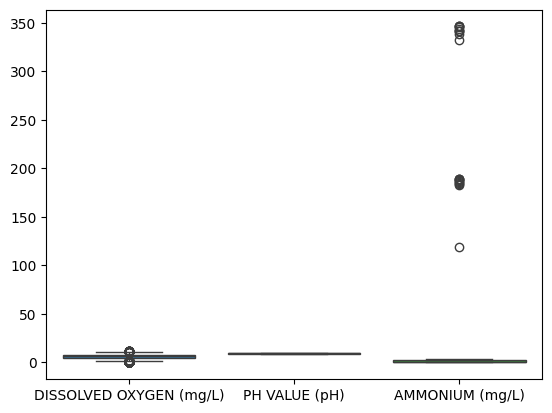

In [ ]:
sns.boxplot(data=df_keep)

#### Detecting Outliers in pH

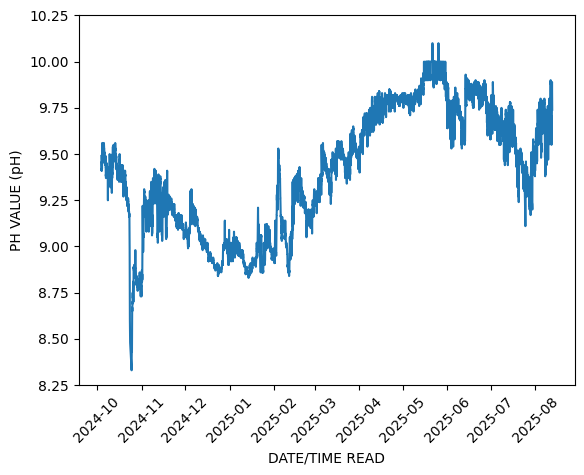

In [ ]:
sns.lineplot(data=df_keep, x=df_keep.index, y="PH VALUE (pH)")
plt.xticks(rotation=45)
plt.ylim(8.25, 10.25)
plt.show()

In [ ]:
Q1_ph = df_keep['PH VALUE (pH)'].quantile(0.25)
Q3_ph = df_keep['PH VALUE (pH)'].quantile(0.75)
IQR_ph = Q3_ph - Q1_ph
min_ph = Q1_ph - 1.5 * IQR_ph
max_ph = Q3_ph + 1.5 * IQR_ph
outliers_ph = df_keep[(df_keep['PH VALUE (pH)'] < min_ph) | (df_keep['PH VALUE (pH)'] > max_ph)]

print(f"Lower Bound: {min_ph}\nUpper Bound: {max_ph}")

print("\nNumber of outliers in PH VALUE (pH):", outliers_ph.shape[0])

Lower Bound: 8.150000000000002
Upper Bound: 10.629999999999999

Number of outliers in PH VALUE (pH): 0


#### Detecting Outliers in Ammonium

In [ ]:
Q1_amm = df_keep['AMMONIUM (mg/L)'].quantile(0.25)
Q3_amm = df_keep['AMMONIUM (mg/L)'].quantile(0.75)
IQR_amm = Q3_amm - Q1_amm
lower_bound_amm = Q1_amm - 1.5 * IQR_amm
upper_bound_amm = Q3_amm + 1.5 * IQR_amm
outliers_amm = df_keep[(df_keep['AMMONIUM (mg/L)'] < lower_bound_amm) | (df_keep['AMMONIUM (mg/L)'] > upper_bound_amm)]

print(outliers_amm['AMMONIUM (mg/L)'].head(21))

print("\nNumber of outliers in AMMONIUM (mg/L):", outliers_amm.shape[0])

DATE/TIME READ
2024-10-04 08:37:06    119.089021
2024-10-04 08:40:12    183.500000
2024-10-04 08:42:13    183.300000
2024-10-04 09:06:08    187.250000
2024-10-04 09:06:54    189.050000
2024-10-04 09:12:03    188.210000
2024-10-04 09:15:31    188.840000
2024-10-04 09:17:58    188.840000
2024-10-04 09:32:40    185.060000
2024-10-04 09:43:11    186.410000
2024-12-23 06:30:49    345.100000
2024-12-23 07:00:50    346.100000
2024-12-23 08:00:49    346.100000
2024-12-23 09:30:51    346.100000
2024-12-23 10:30:50    341.700000
2024-12-23 11:00:52    341.400000
2024-12-23 12:30:50    341.300000
2024-12-23 14:00:48    338.400000
2024-12-23 16:30:52    331.900000
2024-12-23 19:30:50    343.700000
Name: AMMONIUM (mg/L), dtype: float64

Number of outliers in AMMONIUM (mg/L): 20


Outliers in AMMONIUM (mg/L) are clearly sensor errors, hence they will be treated as NaN and interpolated together with the 0.0 values.

In [ ]:
df_keep

,DISSOLVED OXYGEN (mg/L),PH VALUE (pH),AMMONIUM (mg/L)
DATE/TIME READ,,,
2024-10-04 00:01:08,9.89,9.49,3.65
2024-10-04 00:30:57,9.66,9.47,3.57
2024-10-04 01:00:59,9.63,9.47,3.48
2024-10-04 01:31:01,9.42,9.46,3.51
2024-10-04 02:01:01,9.37,9.45,3.32
...,...,...,...
2025-08-12 17:30:00,9.01,9.82,2.85
2025-08-12 18:00:00,2.00,9.83,2.85
2025-08-12 18:30:00,7.85,9.79,2.85


In [ ]:
df_keep = df_keep.reset_index()

In [ ]:
# save data with outliers and 0.0 values for comparison
before = df_keep['AMMONIUM (mg/L)'].copy()

# outliers to NaN
outliers_bool = (df_keep['AMMONIUM (mg/L)'] < lower_bound_amm) | (df_keep['AMMONIUM (mg/L)'] > upper_bound_amm)
df_keep.loc[outliers_bool, 'AMMONIUM (mg/L)'] = np.nan

# 0.0 to NaN
df_keep['AMMONIUM (mg/L)'] = df_keep['AMMONIUM (mg/L)'].replace(0, np.nan)

df_keep = df_keep.set_index("DATE/TIME READ")

# interpolation
df_keep['AMMONIUM (mg/L)'] = df_keep['AMMONIUM (mg/L)'].interpolate(method='time', limit_direction='both')

df_keep = df_keep.reset_index()

# for comparison
after = df_keep['AMMONIUM (mg/L)']
changed_mask = ~before.eq(after)

changes = df_keep.loc[changed_mask, ['DATE/TIME READ']].copy()
changes['before'] = before[changed_mask].values
changes['after']  = after[changed_mask].values

changes

,DATE/TIME READ,before,after
19,2024-10-04 08:37:06,119.089021,3.062835
20,2024-10-04 08:40:12,183.500000,3.053305
21,2024-10-04 08:42:13,183.300000,3.047105
24,2024-10-04 09:06:08,187.250000,2.992238
25,2024-10-04 09:06:54,189.050000,2.991079
26,2024-10-04 09:12:03,188.210000,2.983291
27,2024-10-04 09:15:31,188.840000,2.978049
28,2024-10-04 09:17:58,188.840000,2.974345
29,2024-10-04 09:32:40,185.060000,2.952117
33,2024-10-04 09:43:11,186.410000,2.960000


In [ ]:
print("Before:")
print(before.describe())

print("\nAfter:")
print(after.describe())

Before:
count    15436.000000
mean         1.495156
std          9.847273
min          0.000000
25%          0.290000
50%          0.980000
75%          2.040000
max        346.100000
Name: AMMONIUM (mg/L), dtype: float64

After:
count    15436.000000
mean         1.160726
std          0.863340
min          0.010000
25%          0.290000
50%          0.990000
75%          2.040000
max          3.650000
Name: AMMONIUM (mg/L), dtype: float64


<Axes: >

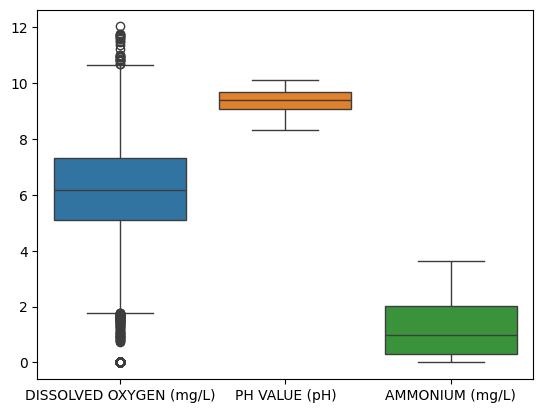

In [ ]:
sns.boxplot(data=df_keep)

In [ ]:
df_keep = df_keep.set_index("DATE/TIME READ")
df_keep.describe()

,DISSOLVED OXYGEN (mg/L),PH VALUE (pH),AMMONIUM (mg/L)
count,15436.000000,15436.000000,15436.000000
mean,5.887771,9.384387,1.160726
std,2.215301,0.342476,0.863340
min,0.000000,8.330000,0.010000
25%,5.100000,9.080000,0.290000
50%,6.190000,9.390000,0.990000
75%,7.322500,9.700000,2.040000
max,12.030000,10.100000,3.650000


#### Detecting Outliers in Dissolved Oxygen

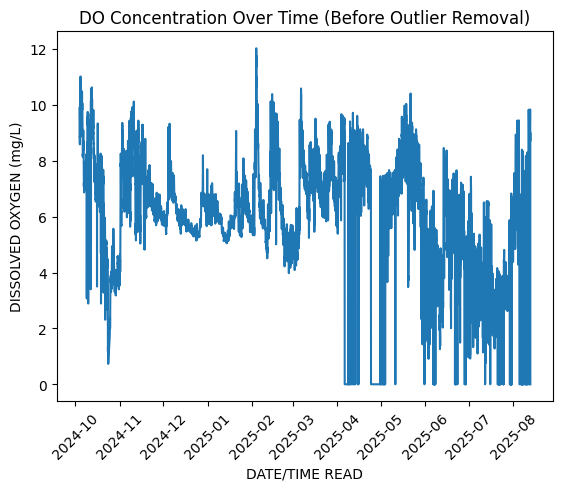

In [ ]:
sns.lineplot(data=df_keep, x=df_keep.index, y="DISSOLVED OXYGEN (mg/L)")
plt.title("DO Concentration Over Time (Before Outlier Removal)")
plt.xticks(rotation=45)
plt.show()

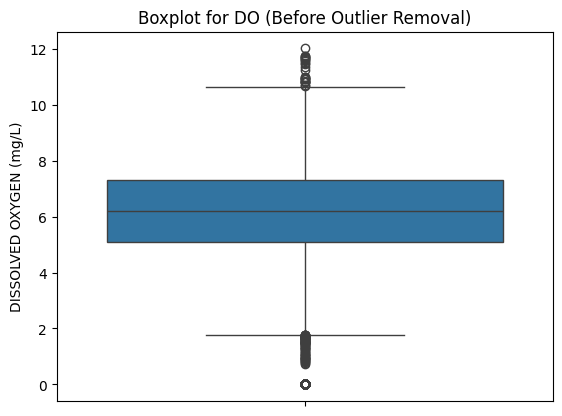

In [ ]:
sns.boxplot(data=df_keep, y="DISSOLVED OXYGEN (mg/L)")
plt.title("Boxplot for DO (Before Outlier Removal)")
plt.show()

In [ ]:
Q1_do = df_keep['DISSOLVED OXYGEN (mg/L)'].quantile(0.25)
Q3_do = df_keep['DISSOLVED OXYGEN (mg/L)'].quantile(0.75)
IQR_do = Q3_do - Q1_do
lower_bound_do = Q1_do - 1.5 * IQR_do
upper_bound_do = Q3_do + 1.5 * IQR_do

print(f"Lower Bound: {lower_bound_do}")
print(f"Upper Bound: {upper_bound_do}")

Lower Bound: 1.7662499999999994
Upper Bound: 10.65625


Outliers below the lower bound are clearly sensor errors since DO levels below 2.0 mg/L are far too low to support aquatic life according to U.S. EPA and there are no reported fish kills in Taal Lake during 20242-2025 so they will be replaced using interpolation.

Additionally, DO levels between 5mg/L to 2mg/L are already stressful for aquatic life but they will be kept because those observations might be caused by the rainy season (June - November).

Furthermore, outliers above upper bound will also be removed even though they are realistic because we want to avoid correlational analysis issues, particularly in line-fitting.

In [ ]:
outliers_do = df_keep[(df_keep['DISSOLVED OXYGEN (mg/L)'] < lower_bound_do) | (df_keep['DISSOLVED OXYGEN (mg/L)'] > upper_bound_do)]

print(outliers_do['DISSOLVED OXYGEN (mg/L)'])

print("\nNumber of outliers in DISSOLVED OXYGEN (mg/L):", outliers_do.shape[0])

print("\nNumber of high outliers in DISSOLVED OXYGEN (mg/L):", df_keep[(df_keep['DISSOLVED OXYGEN (mg/L)'] > upper_bound_do)].shape[0])

DATE/TIME READ
2024-10-04 17:00:51    10.81
2024-10-04 17:30:52    10.83
2024-10-04 18:00:50    11.02
2024-10-04 18:30:50    10.85
2024-10-04 19:00:49    10.95
                       ...  
2025-08-12 11:00:00     0.00
2025-08-12 11:30:00     0.00
2025-08-12 12:00:00     0.00
2025-08-12 12:30:00     0.00
2025-08-12 19:30:00     0.00
Name: DISSOLVED OXYGEN (mg/L), Length: 1042, dtype: float64

Number of outliers in DISSOLVED OXYGEN (mg/L): 1042

Number of high outliers in DISSOLVED OXYGEN (mg/L): 26


In [ ]:
# save data with outliers for comparison
df_keep = df_keep.reset_index()
before_do = df_keep['DISSOLVED OXYGEN (mg/L)'].copy()

# outliers to NaN
outliers_bool_do = (df_keep['DISSOLVED OXYGEN (mg/L)'] < lower_bound_do) | (df_keep['DISSOLVED OXYGEN (mg/L)'] > upper_bound_do)
df_keep.loc[outliers_bool_do, 'DISSOLVED OXYGEN (mg/L)'] = np.nan

df_keep = df_keep.set_index("DATE/TIME READ")

# interpolation
df_keep['DISSOLVED OXYGEN (mg/L)'] = df_keep['DISSOLVED OXYGEN (mg/L)'].interpolate(method='time', limit_direction='both')
df_keep = df_keep.reset_index()

# for comparison
after_do = df_keep['DISSOLVED OXYGEN (mg/L)']
changed_mask_do = ~before_do.eq(after_do)

changes_do = df_keep.loc[changed_mask_do, ['DATE/TIME READ']].copy()
changes_do['before'] = before_do[changed_mask_do].values
changes_do['after']  = after_do[changed_mask_do].values

In [ ]:
changes_do

,DATE/TIME READ,before,after
50,2024-10-04 17:00:51,10.81,10.418740
51,2024-10-04 17:30:52,10.83,10.437500
52,2024-10-04 18:00:50,11.02,10.456229
53,2024-10-04 18:30:50,10.85,10.474979
54,2024-10-04 19:00:49,10.95,10.493719
...,...,...,...
15419,2025-08-12 11:00:00,0.00,7.100000
15420,2025-08-12 11:30:00,0.00,7.455000
15421,2025-08-12 12:00:00,0.00,7.810000
15422,2025-08-12 12:30:00,0.00,8.165000


In [ ]:
df_keep["DISSOLVED OXYGEN (mg/L)"].describe()

,DISSOLVED OXYGEN (mg/L)
count,15436.000000
mean,6.303609
std,1.661421
min,1.770000
25%,5.400000
50%,6.380000
75%,7.415444
max,10.650000


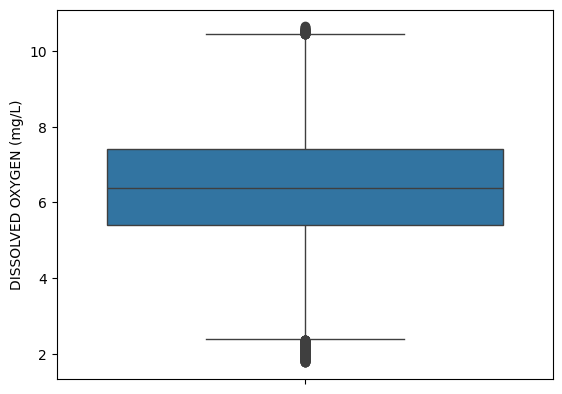

In [ ]:
sns.boxplot(data=df_keep, y="DISSOLVED OXYGEN (mg/L)")
plt.show()

Outliers are still present so we will apply IQR+Interpolation again.

In [ ]:
Q1_do2 = df_keep['DISSOLVED OXYGEN (mg/L)'].quantile(0.25)
Q3_do2 = df_keep['DISSOLVED OXYGEN (mg/L)'].quantile(0.75)
IQR_do2 = Q3_do2 - Q1_do2
lower_bound_do2 = Q1_do2 - 1.5 * IQR_do2
upper_bound_do2 = Q3_do2 + 1.5 * IQR_do2

print(f"Lower Bound: {lower_bound_do2}")
print(f"Upper Bound: {upper_bound_do2}")

Lower Bound: 2.376833333333334
Upper Bound: 10.438611111111111


In [ ]:
outliers_do2 = df_keep[(df_keep['DISSOLVED OXYGEN (mg/L)'] < lower_bound_do2) | (df_keep['DISSOLVED OXYGEN (mg/L)'] > upper_bound_do2)]

print(outliers_do2['DISSOLVED OXYGEN (mg/L)'])

print("\nNumber of outliers in DISSOLVED OXYGEN (mg/L):", outliers_do2.shape[0])

print("\nNumber of high outliers in DISSOLVED OXYGEN (mg/L):", df_keep[(df_keep['DISSOLVED OXYGEN (mg/L)'] > upper_bound_do2)].shape[0])

52       10.456229
53       10.474979
54       10.493719
55       10.512469
56       10.531219
           ...    
14563     1.900000
14564     1.950000
14565     2.360000
14566     2.300000
15432     2.000000
Name: DISSOLVED OXYGEN (mg/L), Length: 283, dtype: float64

Number of outliers in DISSOLVED OXYGEN (mg/L): 283

Number of high outliers in DISSOLVED OXYGEN (mg/L): 31


In [ ]:
# save data with outliers for comparison
before_do2 = df_keep['DISSOLVED OXYGEN (mg/L)'].copy()

# outliers to NaN
outliers_bool_do2 = (df_keep['DISSOLVED OXYGEN (mg/L)'] < lower_bound_do2) | (df_keep['DISSOLVED OXYGEN (mg/L)'] > upper_bound_do2)
df_keep.loc[outliers_bool_do2, 'DISSOLVED OXYGEN (mg/L)'] = np.nan

df_keep = df_keep.set_index("DATE/TIME READ")

# interpolation
df_keep['DISSOLVED OXYGEN (mg/L)'] = df_keep['DISSOLVED OXYGEN (mg/L)'].interpolate(method='time', limit_direction='both')
df_keep = df_keep.reset_index()

# for comparison
after_do2 = df_keep['DISSOLVED OXYGEN (mg/L)']
changed_mask_do2 = ~before_do2.eq(after_do2)

changes_do2 = df_keep.loc[changed_mask_do2, ['DATE/TIME READ']].copy()
changes_do2['before'] = before_do2[changed_mask_do2].values
changes_do2['after']  = after_do2[changed_mask_do2].values

changes_do2

,DATE/TIME READ,before,after
52,2024-10-04 18:00:50,10.456229,10.425569
53,2024-10-04 18:30:50,10.474979,10.413624
54,2024-10-04 19:00:49,10.493719,10.401687
55,2024-10-04 19:30:49,10.512469,10.389742
56,2024-10-04 20:00:49,10.531219,10.377798
...,...,...,...
14563,2025-07-25 04:30:00,1.900000,2.582273
14564,2025-07-25 05:00:00,1.950000,2.605455
14565,2025-07-25 05:30:00,2.360000,2.628636
14566,2025-07-25 06:00:00,2.300000,2.651818


In [ ]:
df_keep["DISSOLVED OXYGEN (mg/L)"].describe()

,DISSOLVED OXYGEN (mg/L)
count,15436.000000
mean,6.312331
std,1.638905
min,2.380000
25%,5.400000
50%,6.380000
75%,7.415444
max,10.437500


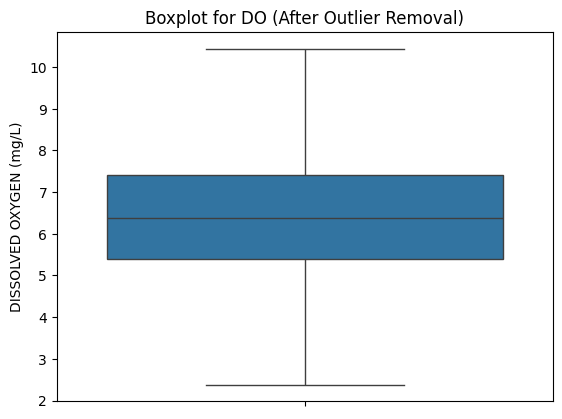

In [ ]:
sns.boxplot(data=df_keep, y="DISSOLVED OXYGEN (mg/L)")
plt.title("Boxplot for DO (After Outlier Removal)")
plt.show()

#### Plot Data without Outliers

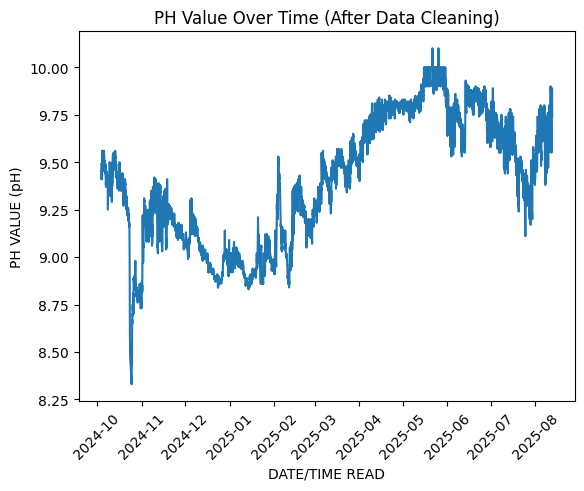

In [ ]:
sns.lineplot(data=df_keep, x="DATE/TIME READ", y="PH VALUE (pH)")
plt.title("PH Value Over Time (After Data Cleaning)")
plt.xticks(rotation=45)
plt.show()

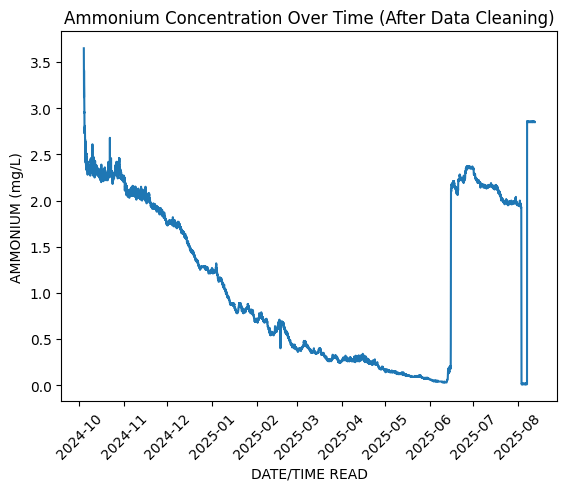

In [ ]:
sns.lineplot(data=df_keep, x="DATE/TIME READ", y="AMMONIUM (mg/L)")
plt.title("Ammonium Concentration Over Time (After Data Cleaning)")
plt.xticks(rotation=45)
plt.show()

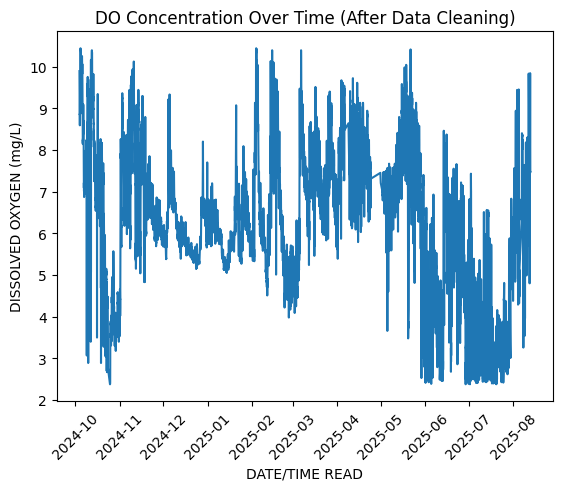

In [ ]:
sns.lineplot(data=df_keep, x="DATE/TIME READ", y="DISSOLVED OXYGEN (mg/L)")
plt.title("DO Concentration Over Time (After Data Cleaning)")
plt.xticks(rotation=45)
plt.show()

## TRANSFORMING DATA TO FORMAT1

#### Create the custom index for later use

In [ ]:
col_dt = "DATE/TIME READ"
col_ph   = "PH VALUE (pH)"
col_amm  = "AMMONIUM (mg/L)"
col_do = "DISSOLVED OXYGEN (mg/L)"
value_cols = [col_ph, col_amm, col_do]

In [ ]:
df_keep = df_keep.set_index(col_dt)

In [ ]:
# build full 30-min grid from first day 00:00 to last day 23:30
first = df_keep.index.normalize().min()
last = df_keep.index.normalize().max()
full_index = pd.date_range(start=first,
                           end = last + pd.Timedelta(hours=23, minutes=30),
                           freq="30min")

# helpers to map to the custom index later
unique_days = full_index.normalize().unique()
day_count  = {d: i + 1 for i, d in enumerate(unique_days)}

print(day_count)

{Timestamp('2024-10-04 00:00:00'): 1, Timestamp('2024-10-05 00:00:00'): 2, Timestamp('2024-10-06 00:00:00'): 3, Timestamp('2024-10-07 00:00:00'): 4, Timestamp('2024-10-08 00:00:00'): 5, Timestamp('2024-10-09 00:00:00'): 6, Timestamp('2024-10-10 00:00:00'): 7, Timestamp('2024-10-11 00:00:00'): 8, Timestamp('2024-10-12 00:00:00'): 9, Timestamp('2024-10-13 00:00:00'): 10, Timestamp('2024-10-14 00:00:00'): 11, Timestamp('2024-10-15 00:00:00'): 12, Timestamp('2024-10-16 00:00:00'): 13, Timestamp('2024-10-17 00:00:00'): 14, Timestamp('2024-10-18 00:00:00'): 15, Timestamp('2024-10-19 00:00:00'): 16, Timestamp('2024-10-20 00:00:00'): 17, Timestamp('2024-10-21 00:00:00'): 18, Timestamp('2024-10-22 00:00:00'): 19, Timestamp('2024-10-23 00:00:00'): 20, Timestamp('2024-10-24 00:00:00'): 21, Timestamp('2024-10-25 00:00:00'): 22, Timestamp('2024-10-26 00:00:00'): 23, Timestamp('2024-10-27 00:00:00'): 24, Timestamp('2024-10-28 00:00:00'): 25, Timestamp('2024-10-29 00:00:00'): 26, Timestamp('2024-10-3

#### Create functions for line-fitting and moving-average fillers

In [ ]:
import builtins as bi

def linefit_then_predict(day_df : pd.DataFrame,
                         time_grid: pd.DatetimeIndex,
                         col : str,
                         k : int = 6) -> pd.Series:
    """
    This creates a straight line y = a + b * t within a single day using the last 6 (k) valid readings of that day,
    then predicts the value at each of the 48 30-min timestamps (time_grid) for that day.
    """
    # keep only rows where the chosen column has a number (no NaN)
    valid_day = day_df[[col]].dropna()

    # if we have fewer than 2 points, we can't fit a line → return all NaN
    if valid_day.shape[0] < 2:
      return pd.Series(np.nan, index=time_grid, dtype=float)

    # use **only the most recent k points** of the day (e.g., last 6 readings)
    take = bi.min(k, len(valid_day))
    valid_day = valid_day.iloc[-take:]

    # we measure time "minutes since midnight" of THIS day
    t0 = time_grid[0].normalize() # e.g., 2024-10-04 00:00

    # x = minutes since midnight for each raw point of this day
    td_raw = (valid_day.index - t0) # TimedeltaIndex
    x = (td_raw / np.timedelta64(1, 'm')).to_numpy() # e.g., [1.0, 37.0, ...]

    # y = the actual sensor values for those points
    y = valid_day[col].to_numpy(dtype=float)

    # do OLS wth guard against degenerate cases.
    x_center = x - x.mean() # center x for better numerics
    denom = float(np.dot(x_center, x_center)) # sum of squares
    if denom == 0.0:
      # if all x are the same → slope 0, intercept = mean(y)
      a = float(np.nanmean(y)); b = 0.0
    else:
      # slope b = cov(x,y)/var(x); intercept a = mean(y) - b*mean(x)
      b = float(np.dot(x_center, (y - y.mean())) / denom)
      a = float(y.mean() - b * x.mean())

    # gx = minutes since midnight for the **grid** (the 48 target timestamps)
    td_grid = (time_grid - t0)
    gx = (td_grid / np.timedelta64(1, 'm')).to_numpy(dtype=float)

    # predicted values = a + b * minutes
    preds = a + b * gx
    return pd.Series(preds, index=time_grid, dtype=float)

In [ ]:
def moving_average_with_linefit(day_df: pd.DataFrame,
                                time_grid: pd.DatetimeIndex,
                                col: str,
                                window_minutes: int = 90,
                                k_linefit: int = 6) -> tuple[pd.Series, pd.Series]:
    """
    For each 30-min timestamp in this **day**:
      1) try a moving-average: average points within ±90
      2) if NONE in that window → use line-fit prediction (above)
    Returns:
      - out_vals: values for all 48 slots of that day
      - did_linefit: True where we had to estimate (line-fit), False if from window mean
    """
    # set up empty containers aligned to the day's 48 timestamps
    out_vals = pd.Series(index=time_grid, dtype=float)
    did_linefit = pd.Series(index=time_grid, dtype=bool)

    # precompute the day's line-fit predictions (we might use them as fallback)
    linefit_preds = linefit_then_predict(day_df, time_grid, col, k=k_linefit)

    # quick access handles to the raw times/values for the chosen column
    raw_times = day_df.index
    raw_values = day_df[col]
    ninety = pd.Timedelta(minutes=window_minutes) # ±90 minutes

    # loop over the 48 timestamps in this day (00:00, 00:30, ... 23:30)
    for mid in time_grid:
      low, high = mid - ninety, mid + ninety # the window around 't' (-90...mid...+90) ->
      mask = (raw_times >= low) & (raw_times <= high) # which raw rows lie in that window?

      if mask.any():
        #  if we have at least one raw reading in the window -> take the mean
        out_vals.loc[mid] = float(raw_values[mask].mean()) # this came from real data near t
        did_linefit[mid] = False # we estimated this one
      else:
        out_vals.loc[mid] = float(linefit_preds.loc[mid])
        did_linefit.loc[mid] = True # estimated via line fit

    # Cap values for DISSOLVED OXYGEN (mg/L) within the calculated IQR bounds
    if col == 'DISSOLVED OXYGEN (mg/L)':
        out_vals = out_vals.clip(lower=lower_bound_do2, upper=upper_bound_do2)


    return out_vals, did_linefit

In [ ]:
format1 = pd.DataFrame(index=full_index)

In [ ]:
flag_cols = [] # we will store the per-variable "estimated flags" here

for col in value_cols: # do pH first, then ammonium
  series_list = [] # will collect the 48-slot values per day
  flag_list = [] # and the corresponding True/False flags per day

  # go day by day (group by calendar date). This prevents cross-day leakage.
  for day, day_slice in df_keep.groupby(df_keep.index.normalize()):
    # the 48 timestamps for this specific day from our big grid
    day_grid = format1.loc[format1.index.normalize() == day].index

    # the raw readings for THIS day and THIS column (drop NaNs)
    day_data = day_slice[[col]].dropna()

    # use the hybrid filler: window mean if any points near the slot, otherwise fallback to the day's line-fit prediction
    vals, est_flag = moving_average_with_linefit(
        day_df = day_data,
        time_grid = day_grid,
        col = col,
        window_minutes = 90,
        k_linefit = 6
    )

    # keep the day’s 48 values and flags
    series_list.append(vals)
    flag_list.append(est_flag)

  # after looping all days, stitch the daily pieces into one big column, round to 2 decimals, and store into the output DataFrame
  format1[col] = pd.concat(series_list).round(2)

  # also save the flags for this variable (True where we estimated)
  flag_cols.append(pd.concat(flag_list))

<Axes: ylabel='DISSOLVED OXYGEN (mg/L)'>

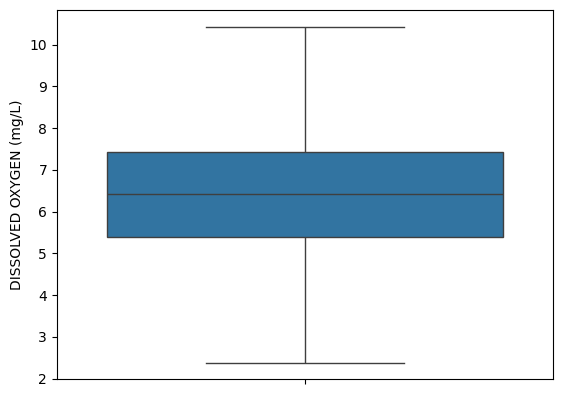

In [ ]:
sns.boxplot(data=format1, y="DISSOLVED OXYGEN (mg/L)")

In [ ]:
if flag_cols:
  interporlated_any = flag_cols[0].copy()
  for f in flag_cols[1:]:
    interporlated_any = interporlated_any | f
  format1["INTERPOLATED"] = interporlated_any.fillna(True) # treat missing lag as True
else:
  format1["INTERPOLATED"] = True

#### Create DAY_HHMM index and check if there are still missing values

In [ ]:
format1["DAY_NUM"] = format1.index.normalize().map(day_count)
format1["HH_MM"]   = format1.index.strftime("%H%M")
format1["DAY_HHMM"] = format1["DAY_NUM"].astype(str) + "-" + format1["HH_MM"]

format1 = format1.drop(columns=["DAY_NUM", "HH_MM"])

In [ ]:
format1.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 15024 entries, 2024-10-04 00:00:00 to 2025-08-12 23:30:00
Freq: 30min
Data columns (total 5 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   PH VALUE (pH)            14928 non-null  float64
 1   AMMONIUM (mg/L)          14928 non-null  float64
 2   DISSOLVED OXYGEN (mg/L)  14928 non-null  float64
 3   INTERPOLATED             14928 non-null  object 
 4   DAY_HHMM                 15024 non-null  object 
dtypes: float64(3), object(2)
memory usage: 704.2+ KB


There are 96 missing observations for every value which is equal to 2 days. These 2 days are probably the days that we dropped when handling missing values before. Identify these days then use **Neighbor-day bridge** to get the average values of the previous day and next day and use them to fill the empty day.

In [ ]:
format1 = format1.set_index("DAY_HHMM")

In [ ]:
# Group by the day part of the index and check for any null values within each day
empty_days = format1.groupby(format1.index.str.split('-').str[0]).apply(lambda x: x.isnull().any().any()).rename("MISSING")

# Filter to show only the days that have missing values
empty_days = empty_days[empty_days]

print("Days with missing values:")
display(empty_days)

Days with missing values:


,MISSING
DAY_HHMM,
21,True
83,True


In [ ]:
# Neighbor-day Bridge

empty_days = [21, 83]

# helpers to parse the composite index "DAY_HHMM"
str_time = format1.index.str[-4:]                               # last 4 chars → "0000",...,"0030"
day_num = format1.index.str.split("-", n=1).str[0].astype(int)  # str[0] selects day number

# function to get a mask (True/False array) for all rows of a given day
def rows_for_day(d):
  return day_num == d

# loop through each missing day we want to fix
for d in empty_days:
  mask_d = rows_for_day(d) # rows of the empty day
  mask_prev = rows_for_day(d - 1) # rows of the previous day
  mask_next = rows_for_day(d + 1) # rows of the next day

  # extract the "HHMM" slot labels for this day and its neighbors
  slots_d = str_time[mask_d]       # e.g. ["0000",...,"2330"] for day d
  slots_prev = str_time[mask_prev] # slots of day d-1
  slots_next = str_time[mask_next] # slots of day d+1

  # fill values column by column (PH and Ammonium)
  for col in value_cols:
    prev_values = pd.Series(format1.loc[mask_prev, col].values, index=slots_prev) # get the values of previous day
    next_values = pd.Series(format1.loc[mask_next, col].values, index=slots_next) # get the values of the next day
    average_values = (prev_values + next_values) / 2.0                            # average the previous and next day values
    format1.loc[mask_d, col] = average_values.loc[slots_d].values                 # put the averaged values into the missing day

  # mark the entire day as interpolated
  format1.loc[mask_d, "INTERPOLATED"] = True

format1[value_cols] = format1[value_cols].round(2)

In [ ]:
format1 = format1.reset_index()
format1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15024 entries, 0 to 15023
Data columns (total 5 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   DAY_HHMM                 15024 non-null  object 
 1   PH VALUE (pH)            15024 non-null  float64
 2   AMMONIUM (mg/L)          15024 non-null  float64
 3   DISSOLVED OXYGEN (mg/L)  15024 non-null  float64
 4   INTERPOLATED             15024 non-null  object 
dtypes: float64(3), object(2)
memory usage: 587.0+ KB


In [ ]:
print(f"\nCount of Interpolated Data: {format1[format1['INTERPOLATED'] == True].shape[0]}")
print(f"Count of Real Data: {format1[format1['INTERPOLATED'] == False].shape[0]}\n")
format1


Count of Interpolated Data: 158
Count of Real Data: 14866



,DAY_HHMM,PH VALUE (pH),AMMONIUM (mg/L),DISSOLVED OXYGEN (mg/L),INTERPOLATED
0,1-0000,9.48,3.57,9.73,False
1,1-0030,9.47,3.55,9.65,False
2,1-0100,9.47,3.51,9.59,False
3,1-0130,9.47,3.50,9.57,False
4,1-0200,9.46,3.46,9.45,False
...,...,...,...,...,...
15019,313-2130,9.68,2.85,6.05,True
15020,313-2200,9.66,2.85,5.72,True
15021,313-2230,9.64,2.85,5.40,True
15022,313-2300,9.62,2.85,5.07,True


In [ ]:
format1 = format1.drop(columns=["INTERPOLATED"])

In [ ]:
format1 = format1.set_index("DAY_HHMM")

In [ ]:
format1

,PH VALUE (pH),AMMONIUM (mg/L),DISSOLVED OXYGEN (mg/L)
DAY_HHMM,,,
1-0000,9.48,3.57,9.73
1-0030,9.47,3.55,9.65
1-0100,9.47,3.51,9.59
1-0130,9.47,3.50,9.57
1-0200,9.46,3.46,9.45
...,...,...,...
313-2130,9.68,2.85,6.05
313-2200,9.66,2.85,5.72
313-2230,9.64,2.85,5.40


#### Check for Outliers after Data Transformation

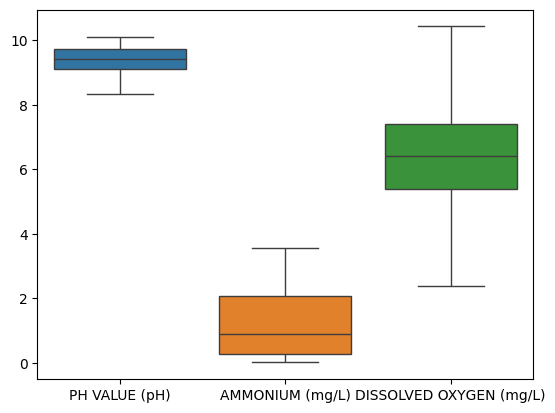

In [ ]:
sns.boxplot(data=format1)
plt.show()

#### Plot Format1

In [ ]:
format1 = format1.reset_index()

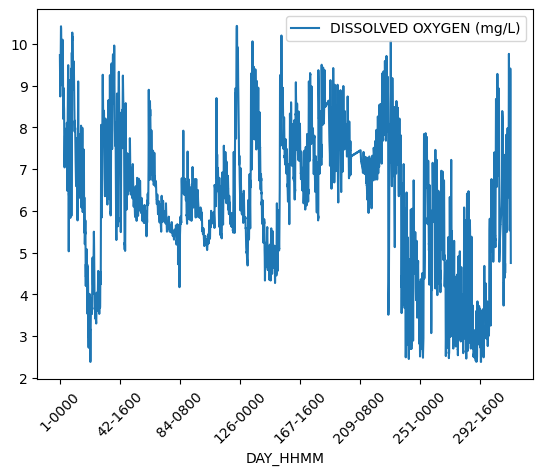

In [ ]:
format1.plot(x="DAY_HHMM", y="DISSOLVED OXYGEN (mg/L)")
plt.xticks(rotation=45)
plt.show()

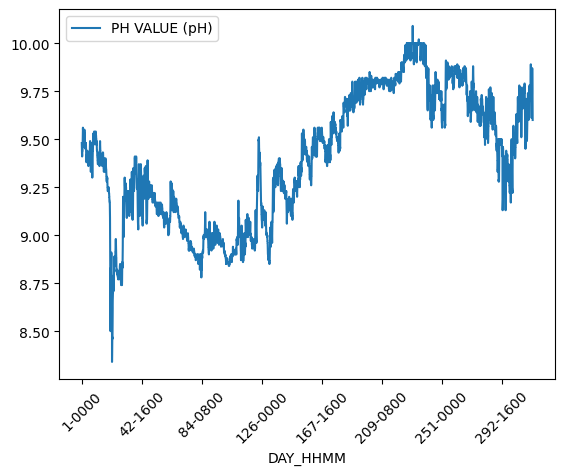

In [ ]:
format1.plot(x="DAY_HHMM", y="PH VALUE (pH)")
plt.xticks(rotation=45)
plt.show()

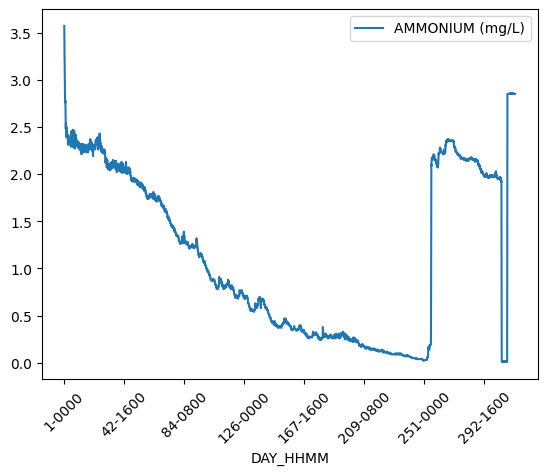

In [ ]:
format1.plot(x="DAY_HHMM", y="AMMONIUM (mg/L)")
plt.xticks(rotation=45)
plt.show()

## CORRELATIONAL ANALYSIS

#### Correlation Matrices using Pearson, Spearman, Kendall

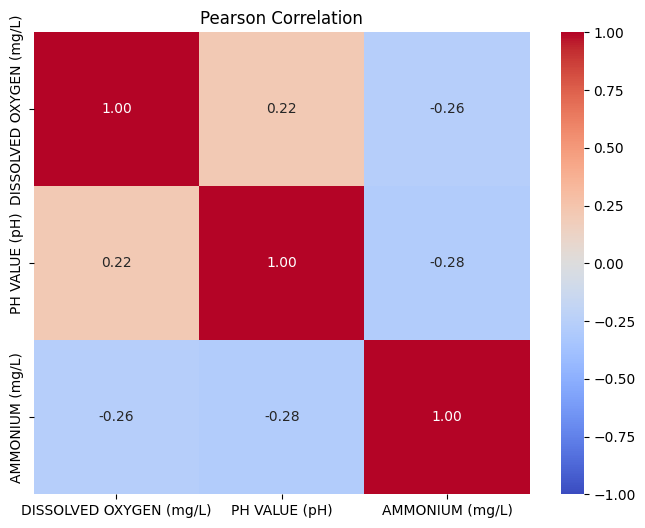

In [ ]:
correlation_matrix = format1[["DISSOLVED OXYGEN (mg/L)", "PH VALUE (pH)", "AMMONIUM (mg/L)"]].corr()

plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1)
plt.title('Pearson Correlation')
plt.show()

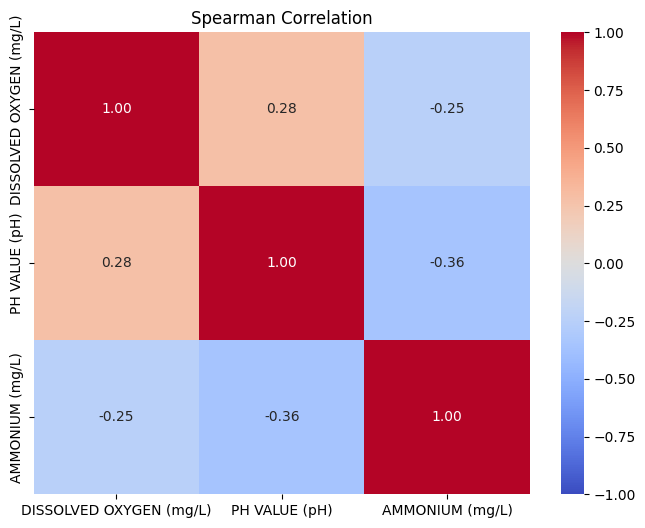

In [ ]:
spearman_corr = format1[["DISSOLVED OXYGEN (mg/L)", "PH VALUE (pH)", "AMMONIUM (mg/L)"]].corr(method='spearman')

plt.figure(figsize=(8, 6))
sns.heatmap(spearman_corr, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1)
plt.title('Spearman Correlation')
plt.show()

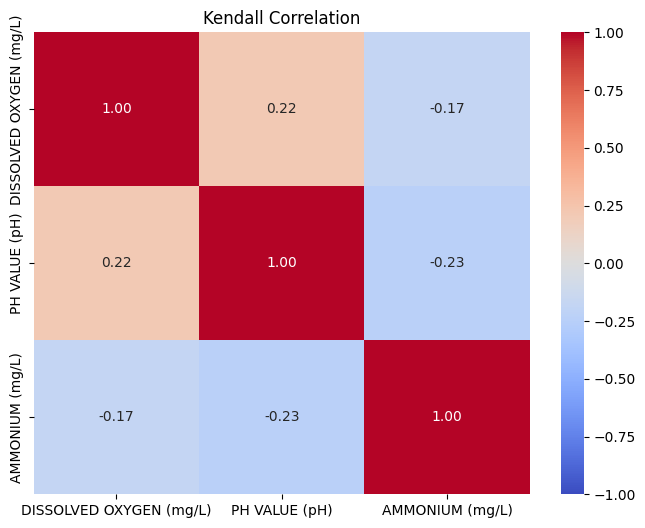

In [ ]:
kendall_corr = format1[["DISSOLVED OXYGEN (mg/L)", "PH VALUE (pH)", "AMMONIUM (mg/L)"]].corr(method='kendall')

plt.figure(figsize=(8, 6))
sns.heatmap(kendall_corr, annot=True, cmap='coolwarm', fmt=".2f", vmin=-1)
plt.title('Kendall Correlation')
plt.show()

**Interpretation:**

The correlation matrices using Pearson, Spearman, and Kendall methods all indicate weak relationships between the variables. Specifically, there's a weak positive correlation between Dissolved Oxygen (DO) and pH, and a weak negative correlation between DO and Ammonium.


#### 2D Scatterplots (Dissolved Oxygen vs pH)

In [ ]:
format1["DATE/TIME"] = full_index
full_index

DatetimeIndex(['2024-10-04 00:00:00', '2024-10-04 00:30:00',
               '2024-10-04 01:00:00', '2024-10-04 01:30:00',
               '2024-10-04 02:00:00', '2024-10-04 02:30:00',
               '2024-10-04 03:00:00', '2024-10-04 03:30:00',
               '2024-10-04 04:00:00', '2024-10-04 04:30:00',
               ...
               '2025-08-12 19:00:00', '2025-08-12 19:30:00',
               '2025-08-12 20:00:00', '2025-08-12 20:30:00',
               '2025-08-12 21:00:00', '2025-08-12 21:30:00',
               '2025-08-12 22:00:00', '2025-08-12 22:30:00',
               '2025-08-12 23:00:00', '2025-08-12 23:30:00'],
              dtype='datetime64[ns]', length=15024, freq='30min')

In [ ]:
color_list = ['midnightblue', 'midnightblue', 'midnightblue', 'midnightblue', 'midnightblue', 'orange', 'orange', 'khaki', 'khaki', 'khaki', 'khaki', 'khaki',
              'yellow', 'yellow', 'yellow', 'yellow', 'yellow', 'red', 'red', 'royalblue', 'royalblue', 'royalblue', 'royalblue', 'royalblue']
cmap = mcolors.LinearSegmentedColormap.from_list("custom_map", color_list, N=24)

Text(0, 0.5, 'PH VALUE (pH)')

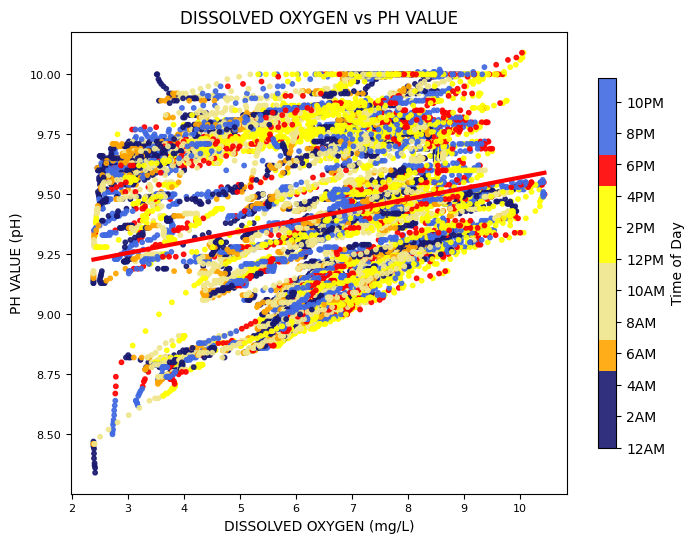

In [ ]:
fig = plt.figure(figsize=[8, 6])
ax = fig.add_subplot()

x = format1["DISSOLVED OXYGEN (mg/L)"]
y = format1["PH VALUE (pH)"]
colors = format1['DATE/TIME'].dt.hour + format1['DATE/TIME'].dt.minute / 60

sp = ax.scatter(x, y, c=colors, cmap=cmap, alpha=0.9, s=10, marker='o')
sns.regplot(x=x, y=y, scatter=False, ax=ax, color='red', line_kws={'linewidth': 3}, ci=None)

tick_positions = np.arange(0, 24, 2)
tick_labels = [f'{h % 12 if h % 12 != 0 else 12}{"AM" if h < 12 else "PM"}' for h in tick_positions]

plt.colorbar(sp, ax=ax, label="Time of Day", shrink=0.8, ticks=tick_positions, format=plt.FuncFormatter(lambda x, _: tick_labels[int(x/2)]))

ax.tick_params(axis='both', which='major', labelsize=8)

ax.set_title(f"DISSOLVED OXYGEN vs PH VALUE")
ax.set_xlabel("DISSOLVED OXYGEN (mg/L)")
ax.set_ylabel("PH VALUE (pH)")

Splitting this scatterplot to 10-day intervals:

In [ ]:
start_date = format1["DATE/TIME"].min()
end_date = format1["DATE/TIME"].max()
intervals = pd.date_range(start=start_date, end=end_date, freq='10D')

if intervals.max() < end_date:
  intervals = intervals.append(pd.Index([end_date]))

print(intervals)

DatetimeIndex(['2024-10-04 00:00:00', '2024-10-14 00:00:00',
               '2024-10-24 00:00:00', '2024-11-03 00:00:00',
               '2024-11-13 00:00:00', '2024-11-23 00:00:00',
               '2024-12-03 00:00:00', '2024-12-13 00:00:00',
               '2024-12-23 00:00:00', '2025-01-02 00:00:00',
               '2025-01-12 00:00:00', '2025-01-22 00:00:00',
               '2025-02-01 00:00:00', '2025-02-11 00:00:00',
               '2025-02-21 00:00:00', '2025-03-03 00:00:00',
               '2025-03-13 00:00:00', '2025-03-23 00:00:00',
               '2025-04-02 00:00:00', '2025-04-12 00:00:00',
               '2025-04-22 00:00:00', '2025-05-02 00:00:00',
               '2025-05-12 00:00:00', '2025-05-22 00:00:00',
               '2025-06-01 00:00:00', '2025-06-11 00:00:00',
               '2025-06-21 00:00:00', '2025-07-01 00:00:00',
               '2025-07-11 00:00:00', '2025-07-21 00:00:00',
               '2025-07-31 00:00:00', '2025-08-10 00:00:00',
               '2025-08-

/tmp/ipython-input-1217930005.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=[8, 6])


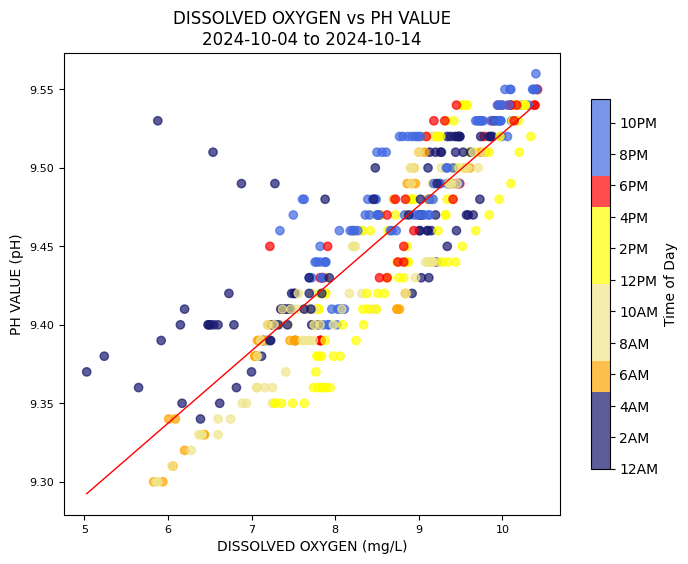

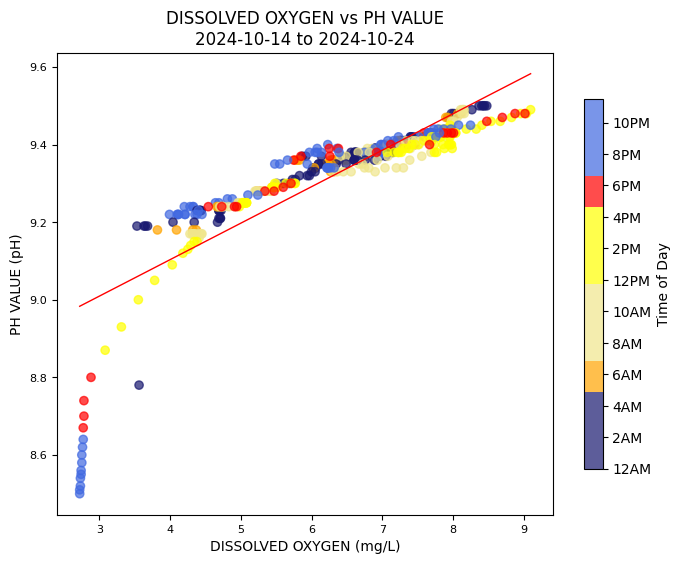

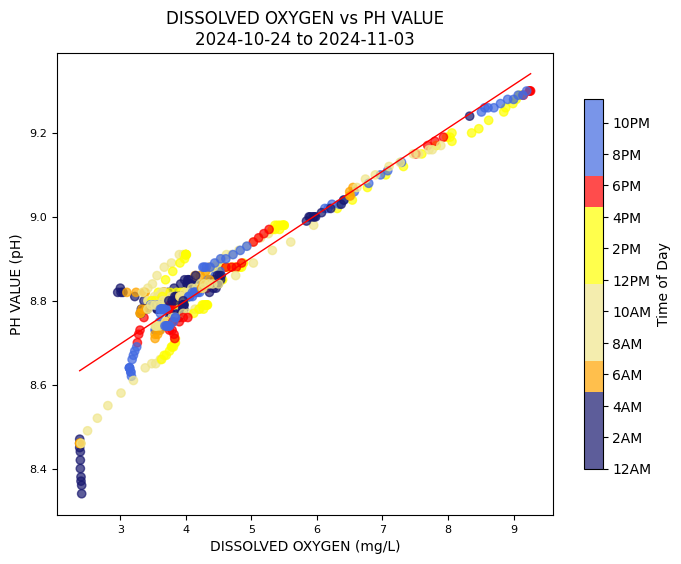

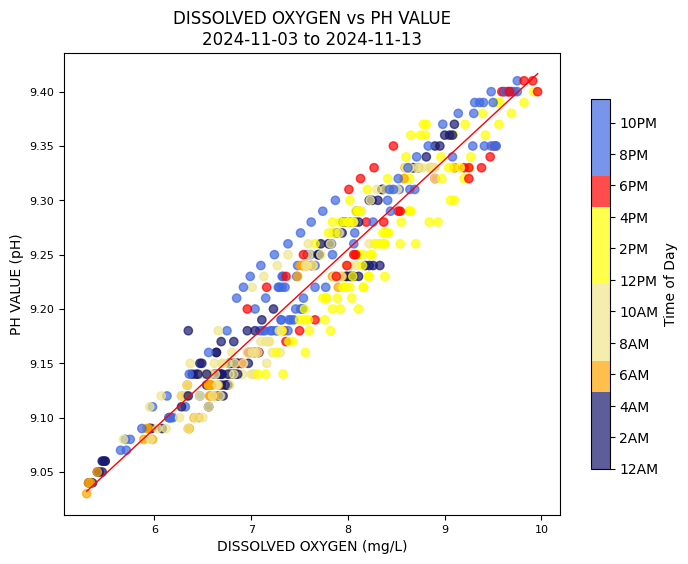

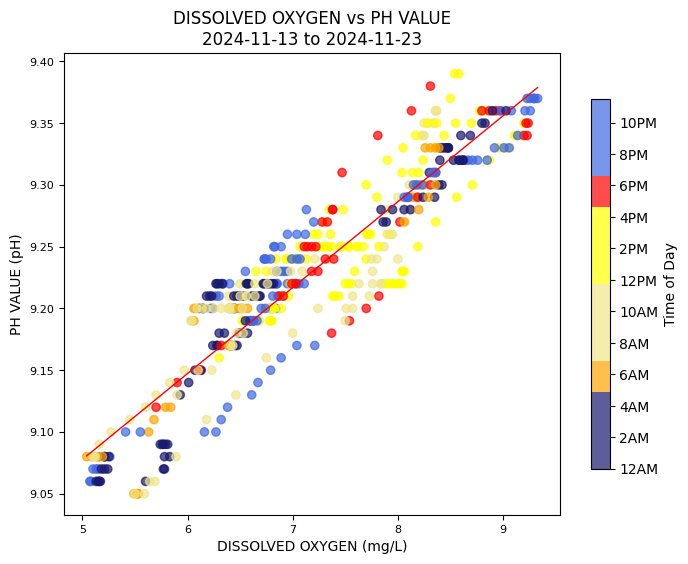

...

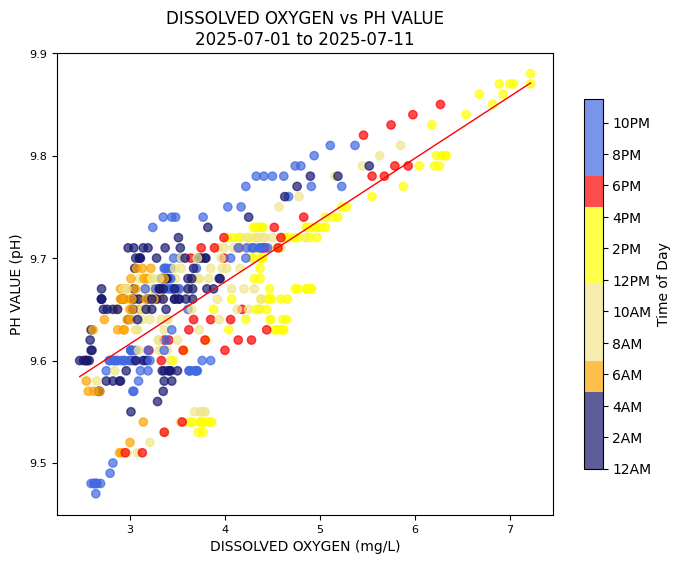

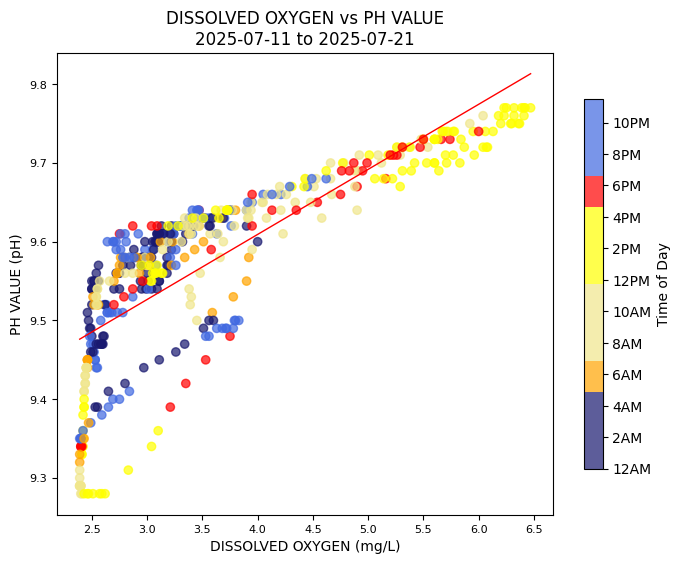

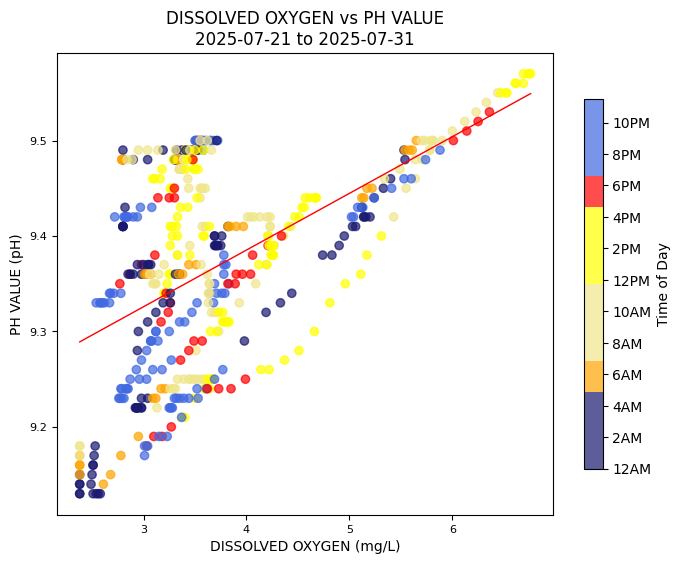

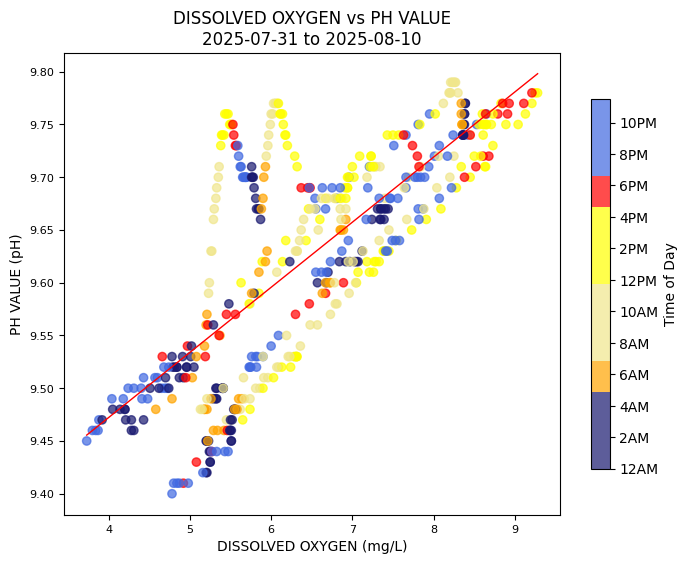

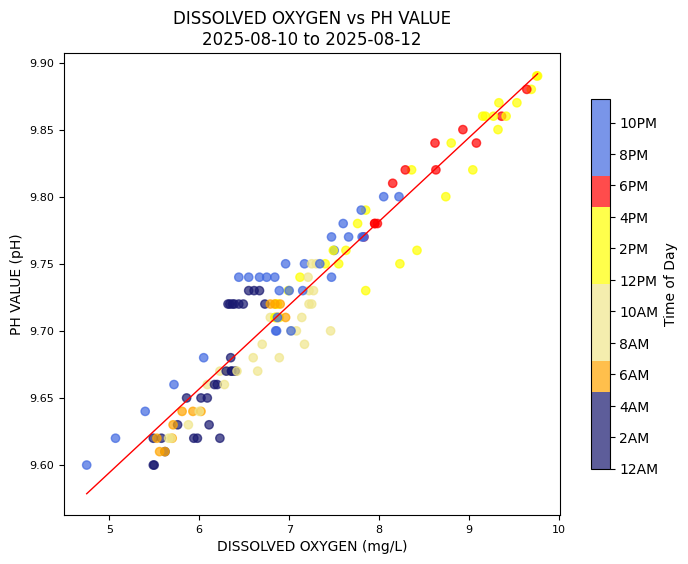

In [ ]:
for i in range(len(intervals) - 1):
  start = intervals[i]
  end = intervals[i+1]

  interval_df = format1[(format1['DATE/TIME'] >= start) & (format1['DATE/TIME'] <= end)]

  if not interval_df.empty:
    fig = plt.figure(figsize=[8, 6])
    ax = fig.add_subplot()

    x = interval_df["DISSOLVED OXYGEN (mg/L)"]
    y = interval_df["PH VALUE (pH)"]
    colors = interval_df['DATE/TIME'].dt.hour + interval_df['DATE/TIME'].dt.minute / 60

    sp = ax.scatter(x, y, c=colors, cmap=cmap, alpha=0.7, marker='o')
    sns.regplot(x=x, y=y, scatter=False, ax=ax, color='red', line_kws={'linewidth': 1}, ci=None)

    tick_positions = np.arange(0, 24, 2)
    tick_labels = [f'{h % 12 if h % 12 != 0 else 12}{"AM" if h < 12 else "PM"}' for h in tick_positions]

    plt.colorbar(sp, ax=ax, label="Time of Day", shrink=0.8, ticks=tick_positions, format=plt.FuncFormatter(lambda x, _: tick_labels[int(x/2)]))

    ax.tick_params(axis='both', which='major', labelsize=8)

    ax.set_title(f"DISSOLVED OXYGEN vs PH VALUE\n{start.strftime('%Y-%m-%d')} to {end.strftime('%Y-%m-%d')}")
    ax.set_xlabel("DISSOLVED OXYGEN (mg/L)")
    ax.set_ylabel("PH VALUE (pH)")

  else:
    print(f"No data found for: {start.strftime('%Y-%m-%d')} to {end.strftime('%Y-%m-%d')}")

**Interpretation:**

Splitting the scatterplot for DO and pH into 10-day intervals reveals a clearer picture than the overall plot. While the overall Pearson correlation is weak, these segmented plots often show more visible patterns. The scatterplots for shorter time periods demonstrate a more evident positive correlation between DO and pH, suggesting that their relationship might be more dynamic and influenced by shorter-term environmental variations within those 10-day windows.

#### 2D Scatterplots (Dissolved Oxygen vs Ammonium)

Text(0, 0.5, 'AMMONIUM (mg/L)')

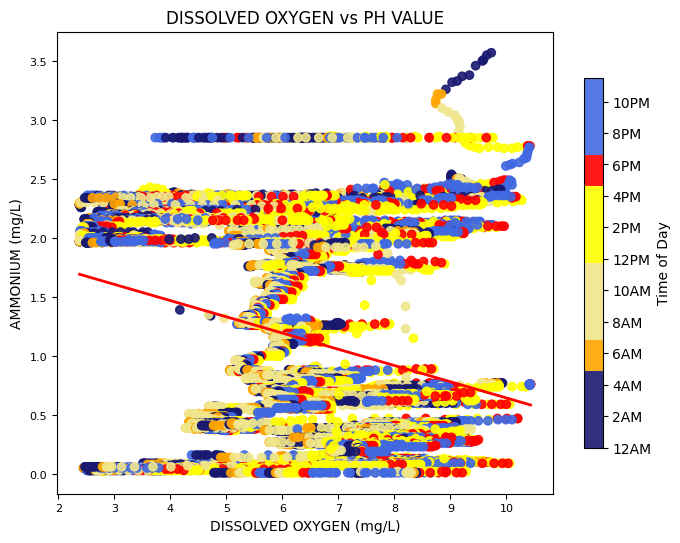

In [ ]:
fig = plt.figure(figsize=[8, 6])
ax = fig.add_subplot()

x = format1["DISSOLVED OXYGEN (mg/L)"]
y = format1["AMMONIUM (mg/L)"]
colors = format1['DATE/TIME'].dt.hour + format1['DATE/TIME'].dt.minute / 60

sp = ax.scatter(x, y, c=colors, cmap=cmap, alpha=0.9, marker='o')
sns.regplot(x=x, y=y, scatter=False, ax=ax, color='red', line_kws={'linewidth': 2}, ci=None)

tick_positions = np.arange(0, 24, 2)
tick_labels = [f'{h % 12 if h % 12 != 0 else 12}{"AM" if h < 12 else "PM"}' for h in tick_positions]

plt.colorbar(sp, ax=ax, label="Time of Day", shrink=0.8, ticks=tick_positions, format=plt.FuncFormatter(lambda x, _: tick_labels[int(x/2)]))

ax.tick_params(axis='both', which='major', labelsize=8)

ax.set_title(f"DISSOLVED OXYGEN vs PH VALUE")
ax.set_xlabel("DISSOLVED OXYGEN (mg/L)")
ax.set_ylabel("AMMONIUM (mg/L)")

Splitting this plot into 10-day intevals:

/tmp/ipython-input-391957562.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=[8, 6])


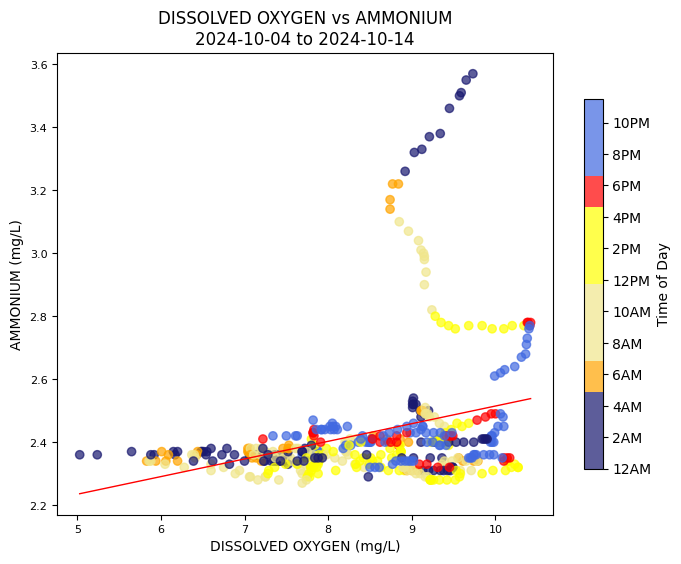

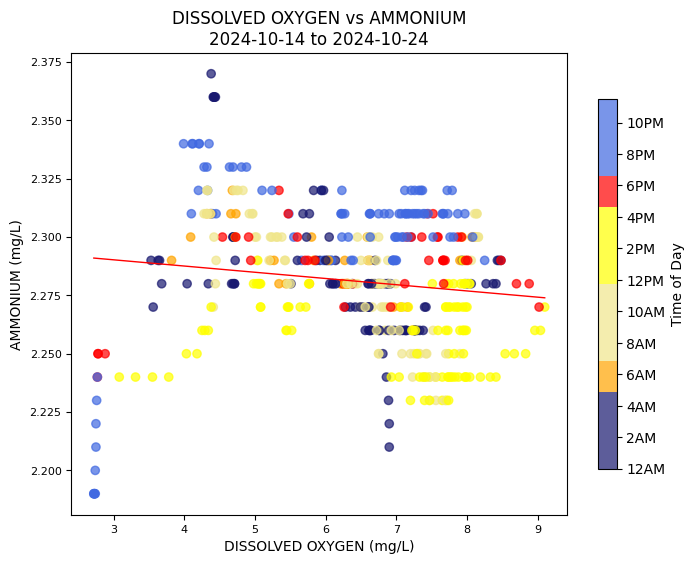

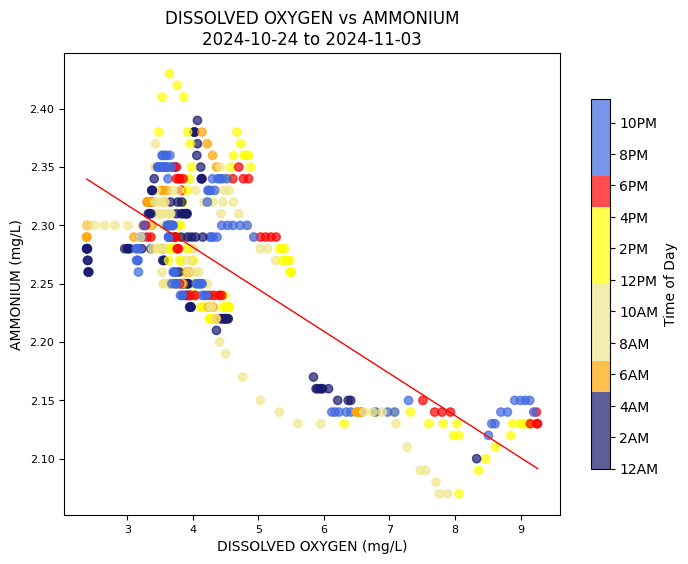

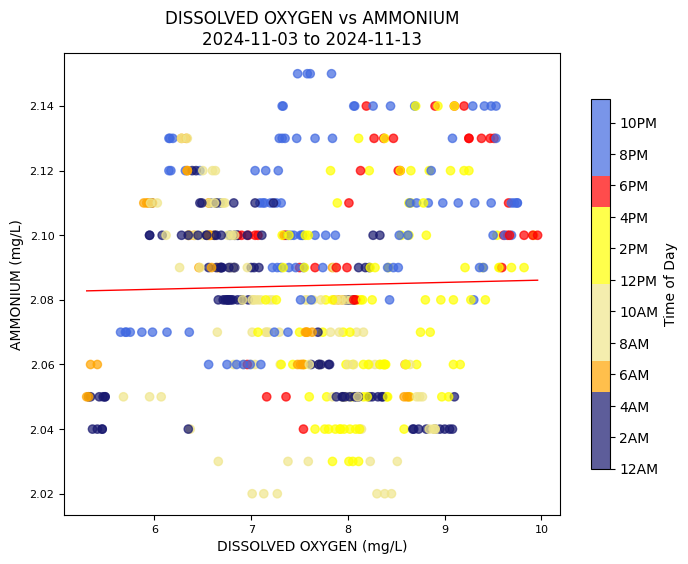

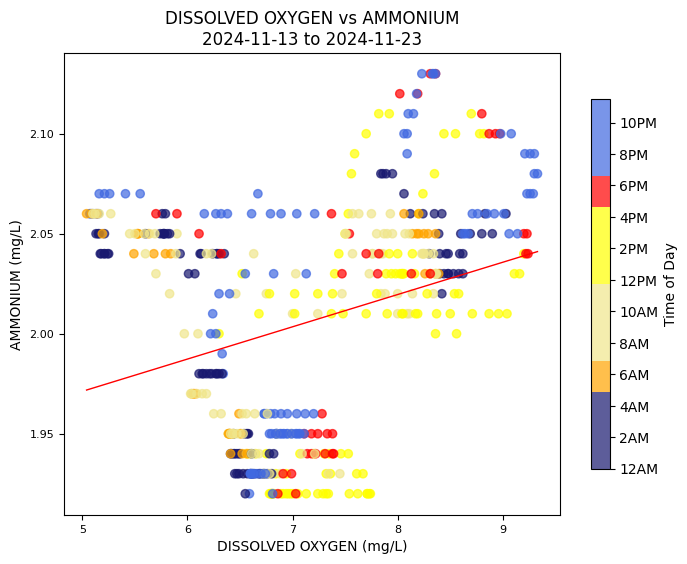

...

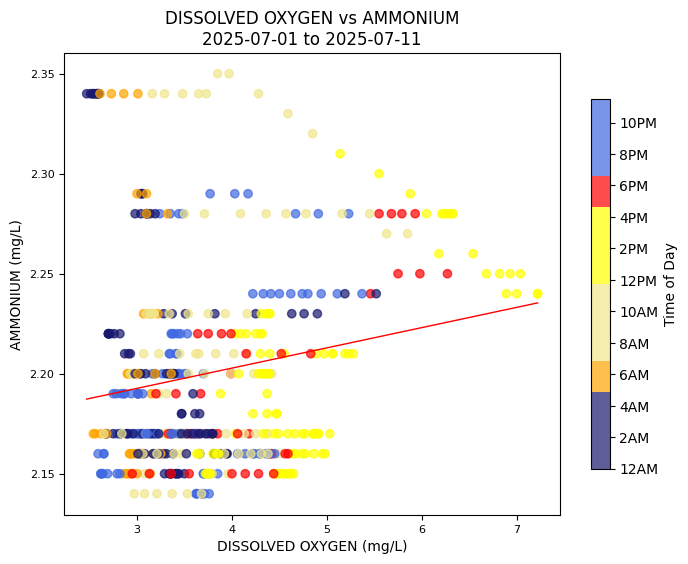

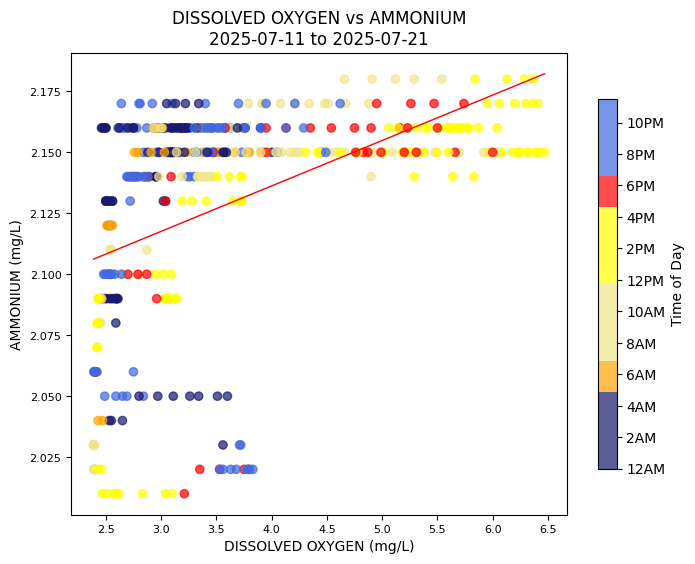

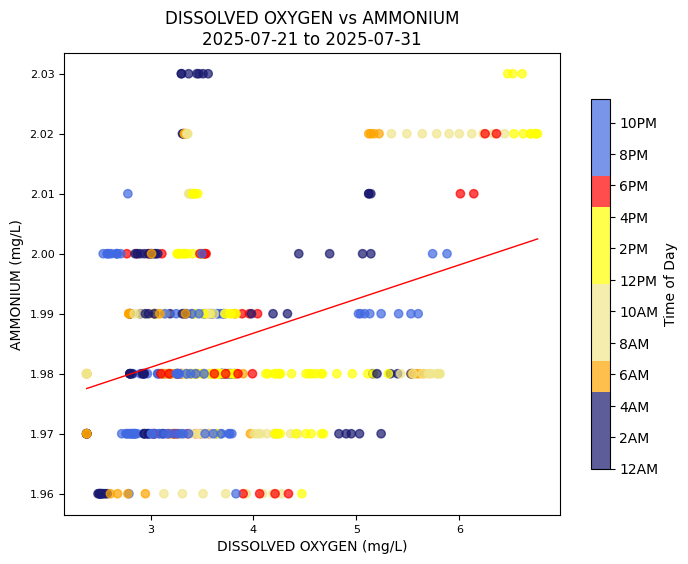

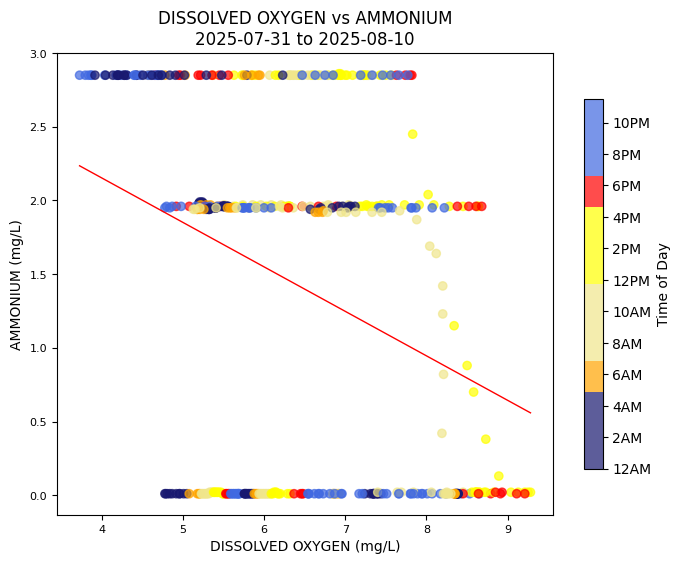

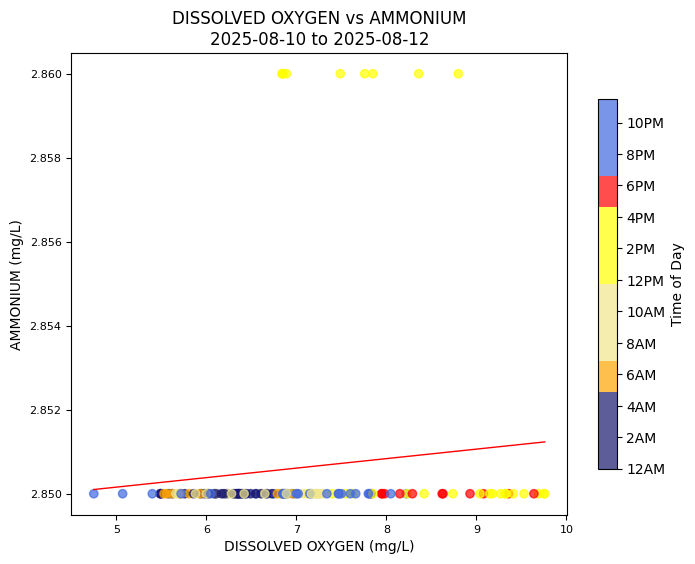

In [ ]:
for i in range(len(intervals) - 1):
  start = intervals[i]
  end = intervals[i+1]

  interval_df = format1[(format1['DATE/TIME'] >= start) & (format1['DATE/TIME'] <= end)]

  if not interval_df.empty:
    fig = plt.figure(figsize=[8, 6])
    ax = fig.add_subplot()

    x = interval_df["DISSOLVED OXYGEN (mg/L)"]
    y = interval_df["AMMONIUM (mg/L)"]
    colors = interval_df['DATE/TIME'].dt.hour + interval_df['DATE/TIME'].dt.minute / 60

    sp = ax.scatter(x, y, c=colors, cmap=cmap, alpha=0.7, marker='o')
    sns.regplot(x=x, y=y, scatter=False, ax=ax, color='red', line_kws={'linewidth': 1}, ci=None)

    # Create custom ticks and labels for 12-hour format
    tick_positions = np.arange(0, 24, 2)
    tick_labels = [f'{h % 12 if h % 12 != 0 else 12}{"AM" if h < 12 else "PM"}' for h in tick_positions]

    plt.colorbar(sp, ax=ax, label="Time of Day", shrink=0.8, ticks=tick_positions, format=plt.FuncFormatter(lambda x, _: tick_labels[int(x/2)]))

    ax.tick_params(axis='both', which='major', labelsize=8)

    ax.set_title(f"DISSOLVED OXYGEN vs AMMONIUM\n{start.strftime('%Y-%m-%d')} to {end.strftime('%Y-%m-%d')}")
    ax.set_xlabel("DISSOLVED OXYGEN (mg/L)")
    ax.set_ylabel("AMMONIUM (mg/L)")

  else:
    print(f"No data found for: {start.strftime('%Y-%m-%d')} to {end.strftime('%Y-%m-%d')}")

**Interpretation:**

The scatterplot of the complete data shows a subtle negative relationship between DO and Ammonium, as also indicated by the correlation matrices. However, splitting this plot into 10-day intervals doesn't reveal strong consistent patterns within those shorter periods.

#### 3D Scatterplots (Colored by DO concentration)

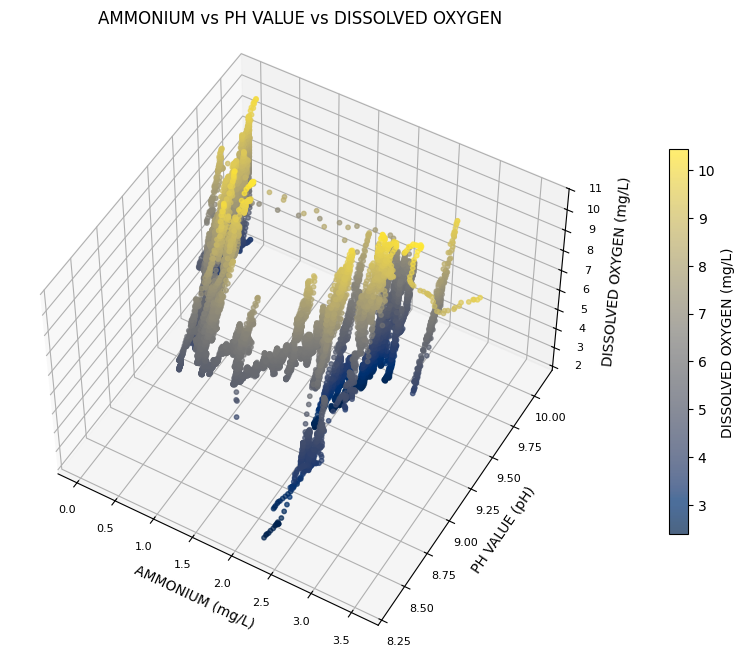

In [ ]:
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection="3d")

xs= format1['AMMONIUM (mg/L)']
ys= format1['PH VALUE (pH)']
zs= format1['DISSOLVED OXYGEN (mg/L)']
colors = zs

# norm = plt.Normalize(vmin=2, vmax=11)
sc = ax.scatter3D(xs, ys, zs, c=colors, cmap='cividis', marker='o', s=10, alpha=0.7)
plt.colorbar(sc, ax=ax, label='DISSOLVED OXYGEN (mg/L)', shrink=0.5, pad=0.10)

ax.view_init(elev=50)
ax.tick_params(axis='both', which='major', labelsize=8)

ax.set_title("AMMONIUM vs PH VALUE vs DISSOLVED OXYGEN", pad=20)
ax.set_xlabel("AMMONIUM (mg/L)")
ax.set_ylabel("PH VALUE (pH)")
ax.set_zlabel("DISSOLVED OXYGEN (mg/L)")

plt.show()

/tmp/ipython-input-2154680072.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=[10, 10])


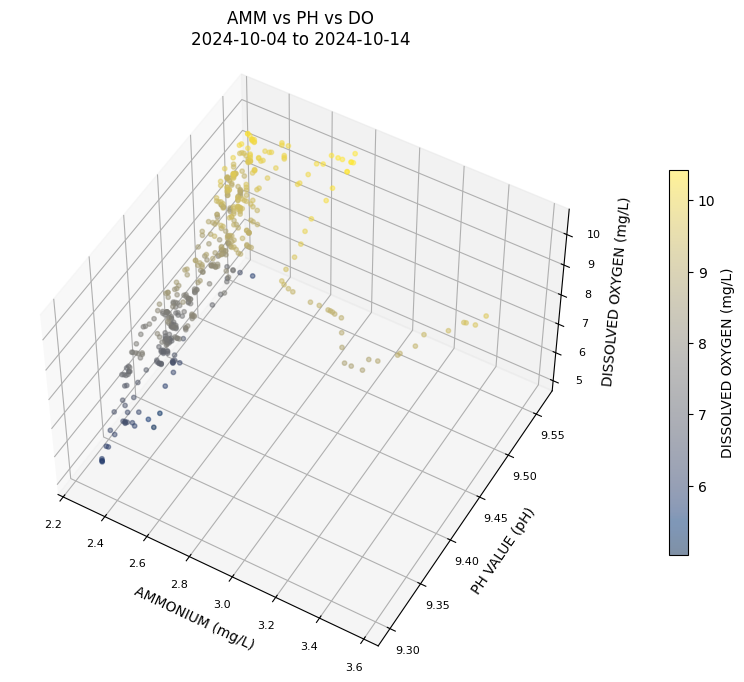

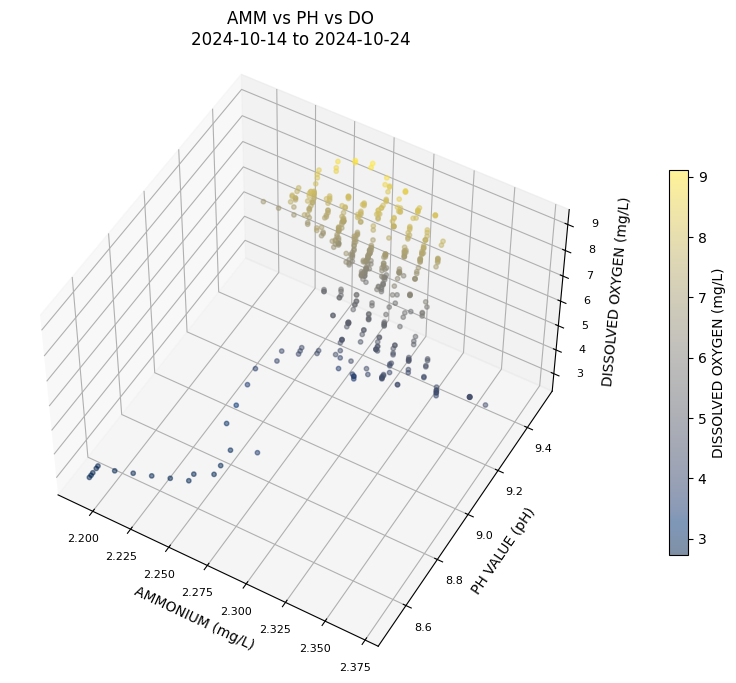

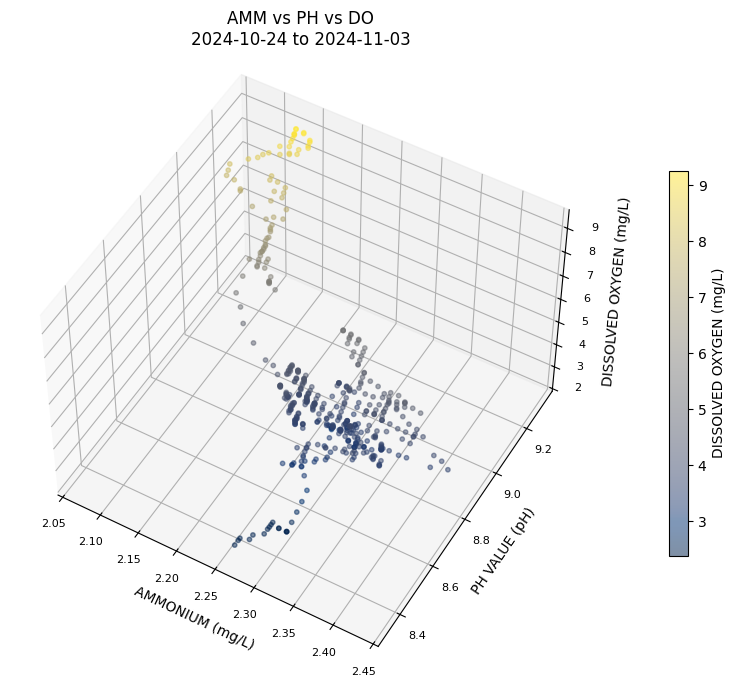

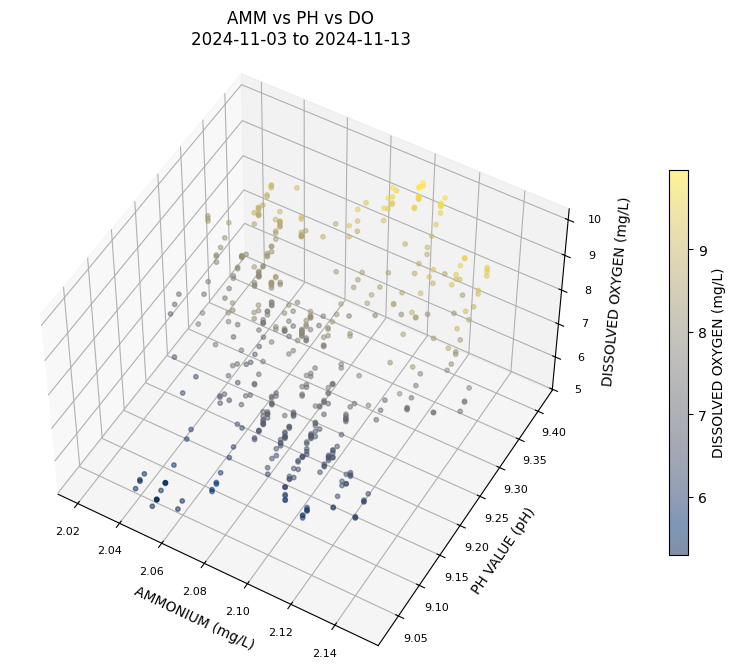

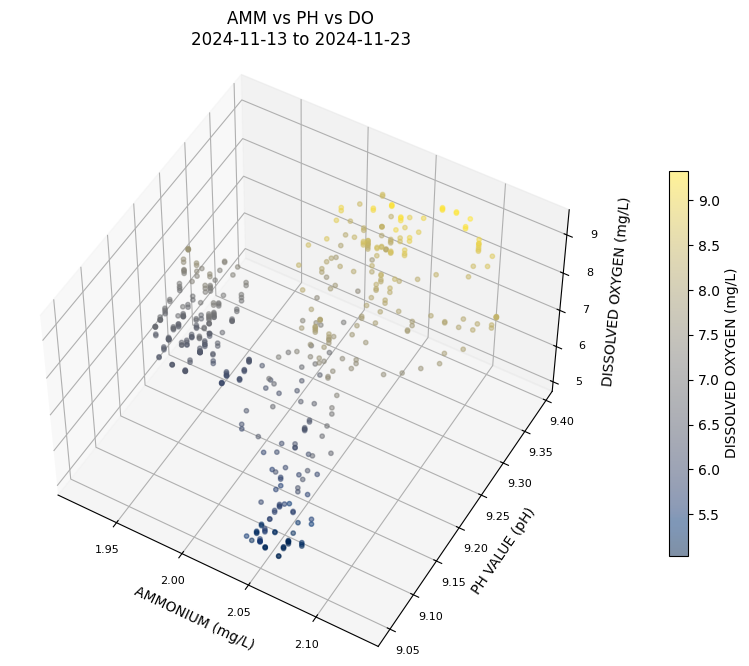

...

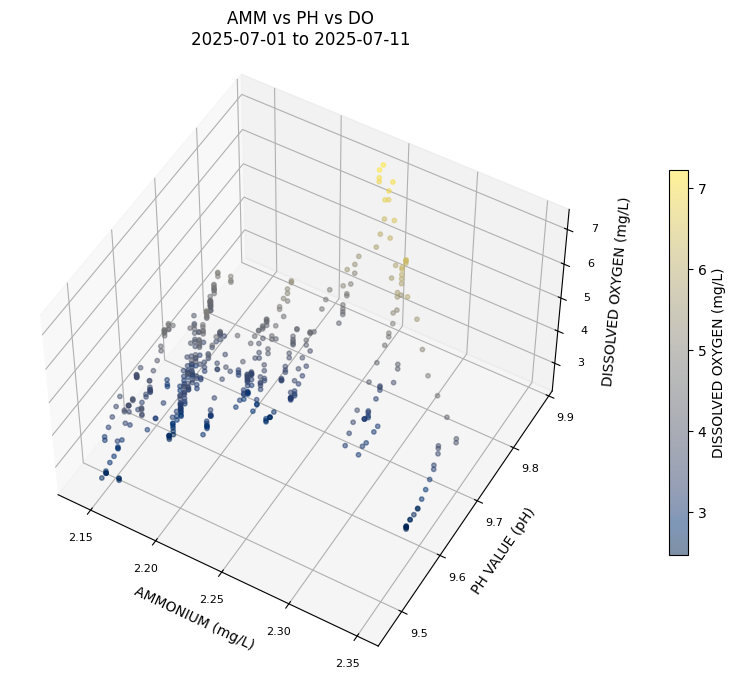

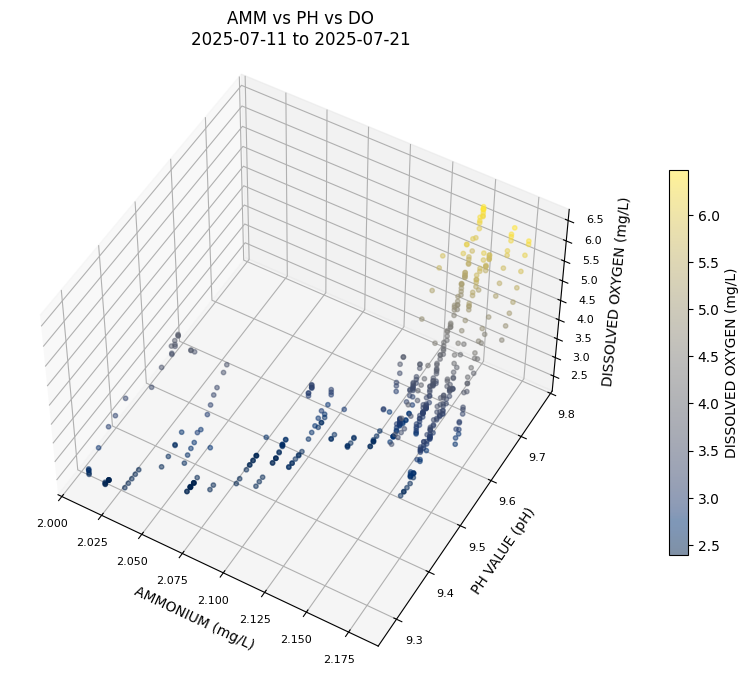

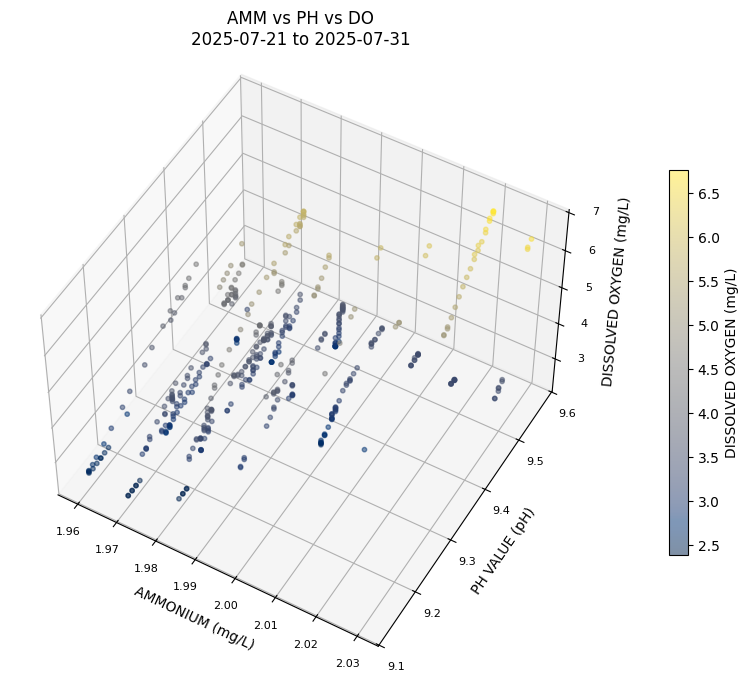

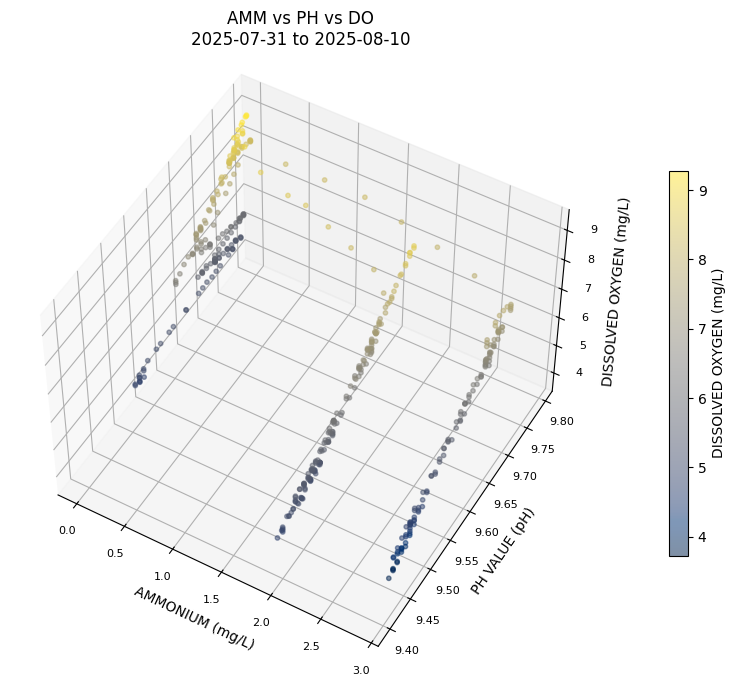

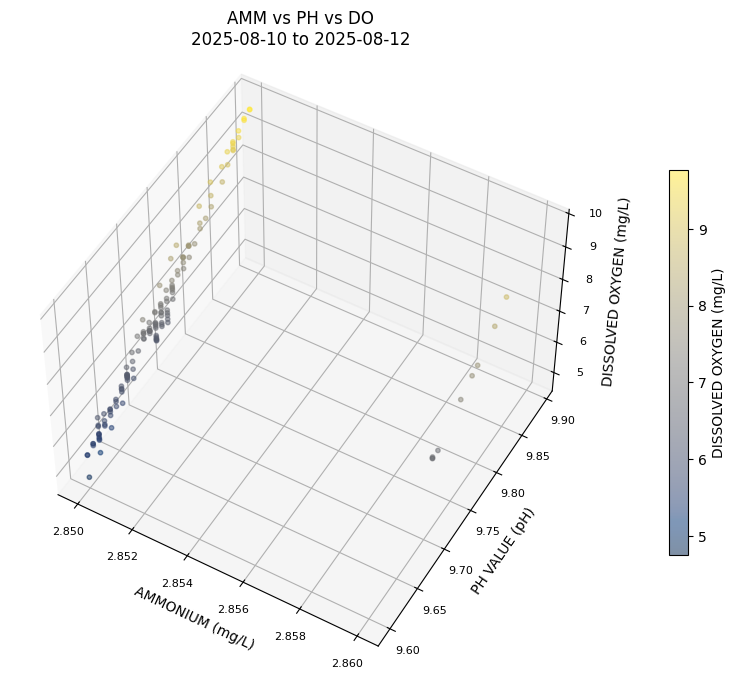

In [ ]:
for i in range(len(intervals) - 1):
  start = intervals[i]
  end = intervals[i+1]

  interval_df = format1[(format1['DATE/TIME'] >= start) & (format1['DATE/TIME'] <= end)]

  if not interval_df.empty:
    fig = plt.figure(figsize=[10, 10])
    ax = fig.add_subplot(111, projection='3d')

    xs = interval_df['AMMONIUM (mg/L)']
    ys = interval_df['PH VALUE (pH)']
    zs = interval_df['DISSOLVED OXYGEN (mg/L)']
    colors = zs

    sp = ax.scatter3D(xs, ys, zs, c=colors, cmap='cividis', alpha=0.5, marker='o', s=10)
    plt.colorbar(sp, ax=ax, label="DISSOLVED OXYGEN (mg/L)", shrink=0.5, pad=0.1)

    ax.view_init(elev=50)
    ax.tick_params(axis='both', which='major', labelsize=8)

    ax.set_title(f"AMM vs PH vs DO\n{start.strftime('%Y-%m-%d')} to {end.strftime('%Y-%m-%d')}", pad=20)
    ax.set_xlabel("AMMONIUM (mg/L)")
    ax.set_ylabel("PH VALUE (pH)")
    ax.set_zlabel("DISSOLVED OXYGEN (mg/L)")

  else:
    print(f"No data found between {start.strftime('%Y-%m-%d')} and {end.strftime('%Y-%m-%d')}.", pad=20)

**Interpretation:**

The 3D scatterplots colored by Dissolved Oxygen (DO) concentration provide a more comprehensive view of the relationships between Ammonium, pH, and DO. As observed, higher pH values (indicated by yellower colors in the DO scale when pH is high) tend to correspond to higher dissolved oxygen levels, reinforcing the weak positive correlation seen earlier. Conversely, as ammonium concentration increases, dissolved oxygen tends to decrease (indicated by bluer colors in the DO scale as Ammonium increases). This negative relationship is biologically plausible, as the nitrification process (conversion of ammonium to nitrate) by microorganisms consumes dissolved oxygen. The plots visually confirm the observation that DO is generally highest when Ammonium is low and pH is high, and lowest when Ammonium is high and pH is moderate.

#### 3D Scatterplots (Colored by hour of day)

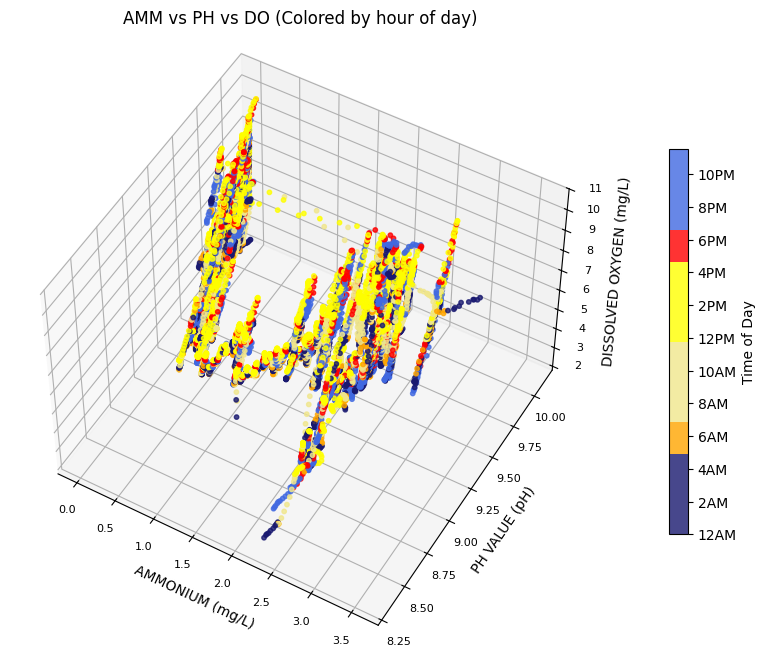

In [ ]:
fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(111, projection='3d')

xs = format1["AMMONIUM (mg/L)"]
ys = format1["PH VALUE (pH)"]
zs = format1["DISSOLVED OXYGEN (mg/L)"]
colors = format1['DATE/TIME'].dt.hour + format1['DATE/TIME'].dt.minute / 60

sp = ax.scatter3D(xs, ys, zs, c=colors, cmap=cmap, alpha=0.8, s=10, marker='o')

tick_positions = np.arange(0, 24, 2)
tick_labels = [f'{h % 12 if h % 12 != 0 else 12}{"AM" if h < 12 else "PM"}' for h in tick_positions]

plt.colorbar(sp, ax=ax, label="Time of Day", shrink=0.5, pad=0.1, ticks=tick_positions, format=plt.FuncFormatter(lambda x, _: tick_labels[int(x/2)]))

ax.view_init(elev=50)
ax.tick_params(axis='both', which='major', labelsize=8)

ax.set_title(f"AMM vs PH vs DO (Colored by hour of day)", pad=20)
ax.set_xlabel("AMMONIUM (mg/L)")
ax.set_ylabel("PH VALUE (pH)")
ax.set_zlabel("DISSOLVED OXYGEN (mg/L)")

plt.show()

/tmp/ipython-input-3562222180.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=[10, 10])


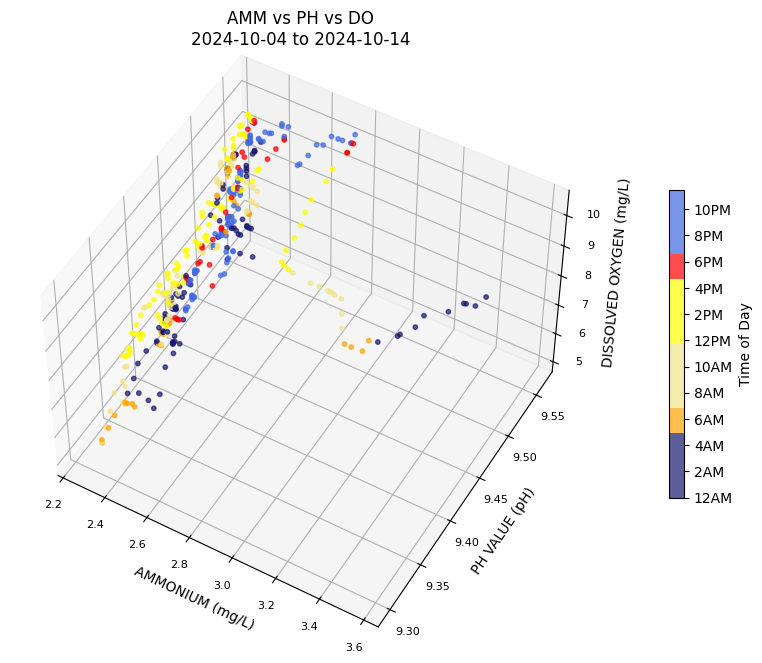

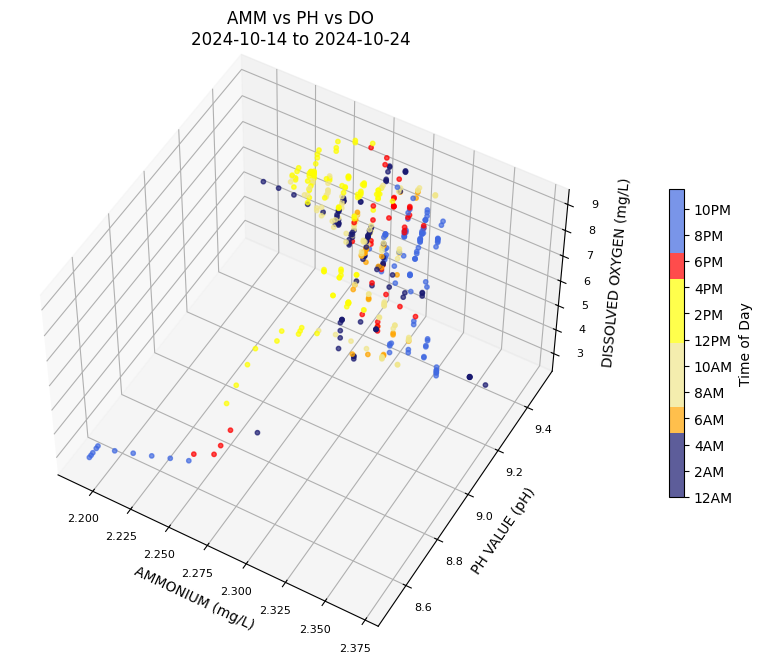

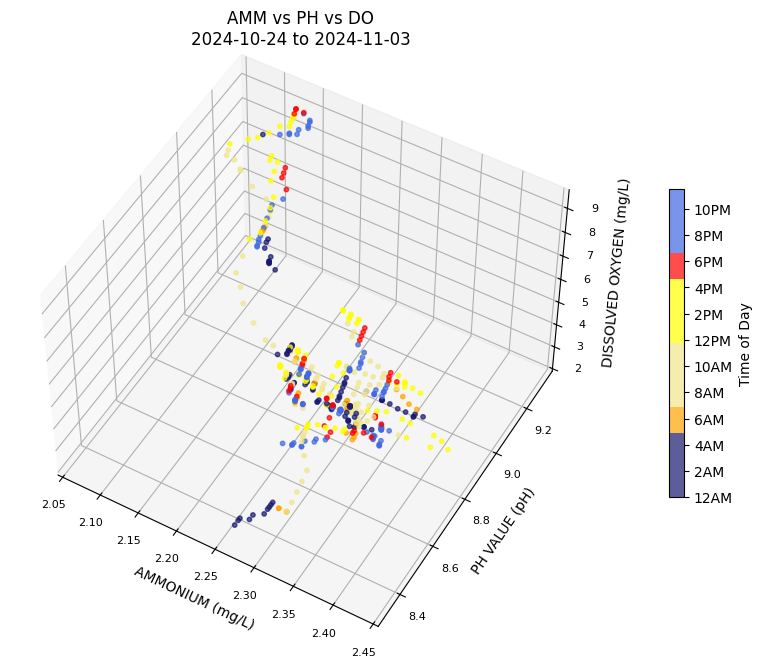

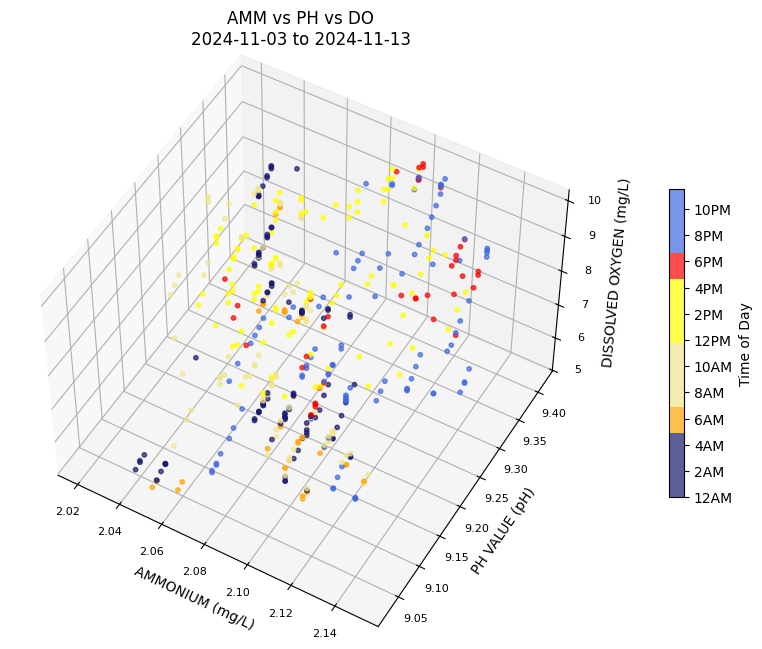

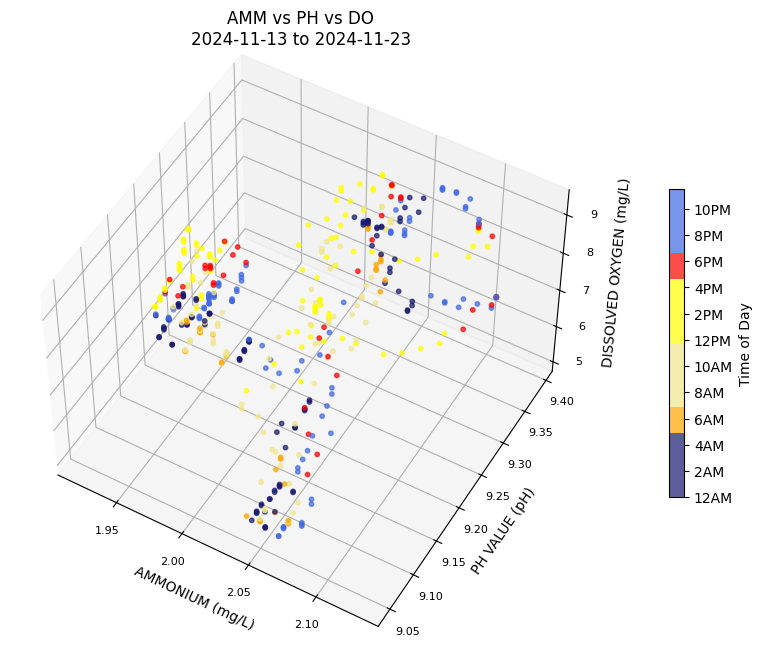

...

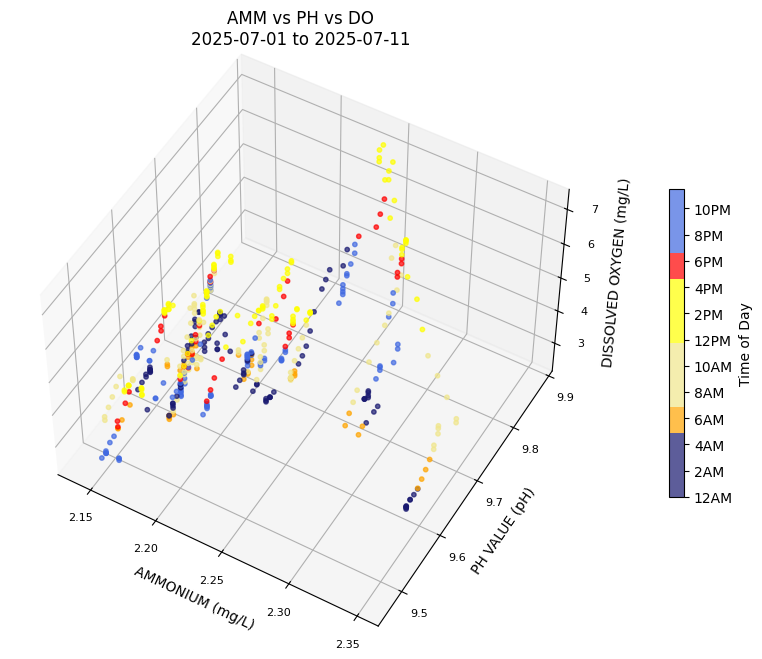

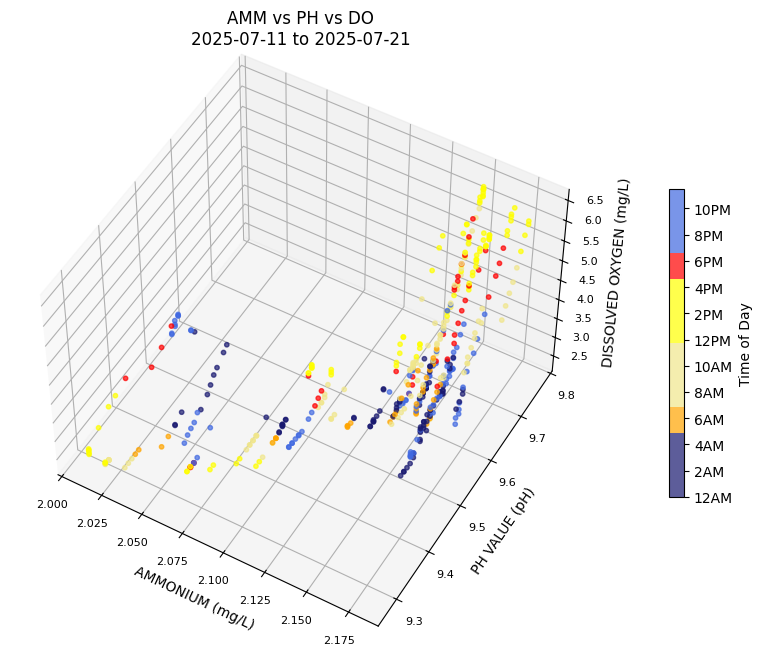

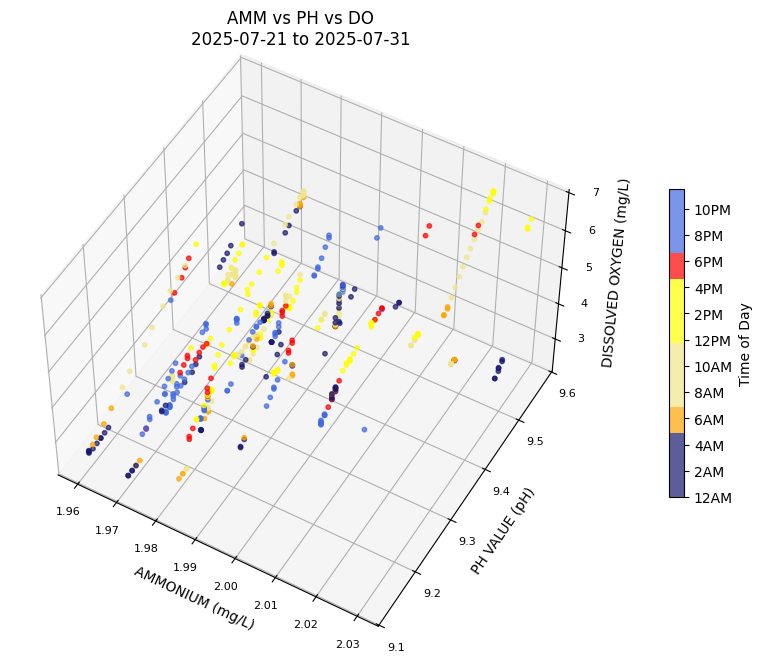

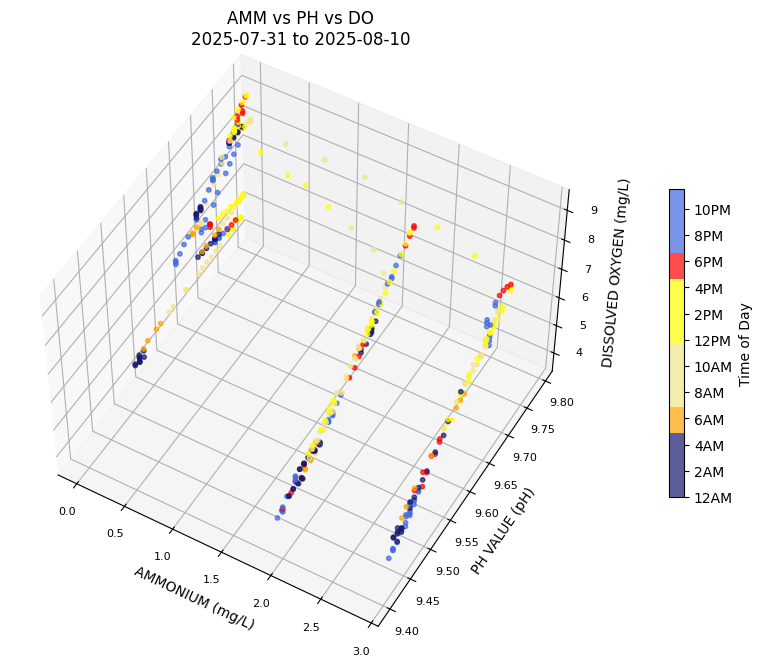

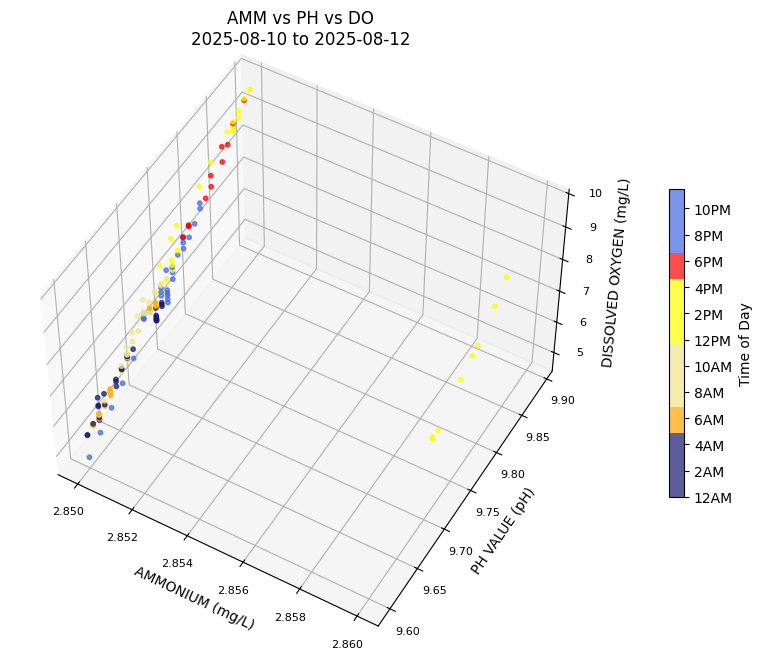

In [ ]:
for i in range(len(intervals) - 1):
  start = intervals[i]
  end = intervals[i+1]

  interval_df = format1[(format1['DATE/TIME'] >= start) & (format1['DATE/TIME'] <= end)]

  if not interval_df.empty:
    fig = plt.figure(figsize=[10, 10])
    ax = fig.add_subplot(111, projection='3d')

    xs = interval_df["AMMONIUM (mg/L)"]
    ys = interval_df["PH VALUE (pH)"]
    zs = interval_df["DISSOLVED OXYGEN (mg/L)"]
    colors = interval_df['DATE/TIME'].dt.hour + interval_df['DATE/TIME'].dt.minute / 60

    sp = ax.scatter3D(xs, ys, zs, c=colors, cmap=cmap, alpha=0.7, s=10, marker='o')

    tick_positions = np.arange(0, 24, 2)
    tick_labels = [f'{h % 12 if h % 12 != 0 else 12}{"AM" if h < 12 else "PM"}' for h in tick_positions]

    plt.colorbar(sp, ax=ax, label="Time of Day", shrink=0.4, pad=0.1, ticks=tick_positions, format=plt.FuncFormatter(lambda x, _: tick_labels[int(x/2)]))

    ax.view_init(elev=50)
    ax.tick_params(axis='both', which='major', labelsize=8)

    ax.set_title(f"AMM vs PH vs DO\n{start.strftime('%Y-%m-%d')} to {end.strftime('%Y-%m-%d')}")
    ax.set_xlabel("AMMONIUM (mg/L)")
    ax.set_ylabel("PH VALUE (pH)")
    ax.set_zlabel("DISSOLVED OXYGEN (mg/L)")

  else:
    print(f"No data found for: {start.strftime('%Y-%m-%d')} to {end.strftime('%Y-%m-%d')}", pad=20)

**Interpretation:**

The 3D scatterplots colored by the hour of the day provide valuable insights into the diurnal patterns of the water quality parameters. The distribution of colors clearly shows a cyclical pattern, with higher dissolved oxygen levels (yellow-red colors) generally occurring during daylight hours (roughly 6 AM to 6 PM). This is consistent with the understanding that photosynthesis by aquatic plants and algae produces oxygen during the day. Conversely, lower DO levels (blue shades) are more prevalent during nighttime hours (roughly 6 PM to 6 AM), when respiration by aquatic organisms consumes oxygen. The plots illustrate that dissolved oxygen tends to peak during the daytime, particularly when pH is high and ammonium is low, and decreases during the night. While the data points are spread, the overall trend strongly suggests a significant diurnal oxygen cycle driven by the balance between photosynthesis and respiration over a 24-hour period.

## LAGGED CORRELATION (experimental)

#### Creating a lagged dataframe

In [ ]:
format1.head()

,DAY_HHMM,PH VALUE (pH),AMMONIUM (mg/L),DISSOLVED OXYGEN (mg/L),DATE/TIME
0,1-0000,9.48,3.57,9.73,2024-10-04 00:00:00
1,1-0030,9.47,3.55,9.65,2024-10-04 00:30:00
2,1-0100,9.47,3.51,9.59,2024-10-04 01:00:00
3,1-0130,9.47,3.50,9.57,2024-10-04 01:30:00
4,1-0200,9.46,3.46,9.45,2024-10-04 02:00:00


In [ ]:
lag_mins = [30, 60, 90, 120, 150, 180]

# Initialize the lagged DataFrame with the original columns
lagged = format1[["DAY_HHMM", "PH VALUE (pH)", "AMMONIUM (mg/L)"]].copy()
lagged = lagged.set_index("DAY_HHMM") # Set DAY_HHMM as the index

# Create lagged columns for PH VALUE (pH)
for i, m in enumerate(lag_mins, start=1):
  lagged[f"PH_LAST_{m}"] = lagged["PH VALUE (pH)"].shift(i)

# Create lagged columns for AMMONIUM (mg/L)
for i, m in enumerate(lag_mins, start=1):
  lagged[f"AMM_LAST_{m}"] = lagged["AMMONIUM (mg/L)"].shift(i)

lagged

,PH VALUE (pH),AMMONIUM (mg/L),PH_LAST_30,PH_LAST_60,PH_LAST_90,PH_LAST_120,PH_LAST_150,PH_LAST_180,AMM_LAST_30,AMM_LAST_60,AMM_LAST_90,AMM_LAST_120,AMM_LAST_150,AMM_LAST_180
DAY_HHMM,,,,,,,,,,,,,,
1-0000,9.48,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1-0030,9.47,3.55,9.48,NaN,NaN,NaN,NaN,NaN,3.57,NaN,NaN,NaN,NaN,NaN
1-0100,9.47,3.51,9.47,9.48,NaN,NaN,NaN,NaN,3.55,3.57,NaN,NaN,NaN,NaN
1-0130,9.47,3.50,9.47,9.47,9.48,NaN,NaN,NaN,3.51,3.55,3.57,NaN,NaN,NaN
1-0200,9.46,3.46,9.47,9.47,9.47,9.48,NaN,NaN,3.50,3.51,3.55,3.57,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
313-2130,9.68,2.85,9.74,9.77,9.78,9.79,9.80,9.81,2.85,2.85,2.85,2.85,2.85,2.85
313-2200,9.66,2.85,9.68,9.74,9.77,9.78,9.79,9.80,2.85,2.85,2.85,2.85,2.85,2.85
313-2230,9.64,2.85,9.66,9.68,9.74,9.77,9.78,9.79,2.85,2.85,2.85,2.85,2.85,2.85


In [ ]:
lag_cols = ["PH VALUE (pH)","PH_LAST_30","PH_LAST_60","PH_LAST_90","PH_LAST_120","PH_LAST_150","PH_LAST_180",
            "AMMONIUM (mg/L)","AMM_LAST_30","AMM_LAST_60","AMM_LAST_90","AMM_LAST_120","AMM_LAST_150","AMM_LAST_180"]

def fill_leading_with_linefit(s: pd.Series, k: int = 6) -> pd.Series:
    """Fill leading NaNs using a straight line fit from the first k valid points."""
    first_valid = s.first_valid_index()
    if first_valid is None:
        return s  # nothing to fit
    first_pos = s.index.get_loc(first_valid)
    if first_pos == 0:
        return s  # no leading NaNs

    # use first k valid points
    valid_vals = s.dropna().iloc[:k]
    x = np.arange(len(valid_vals))                # 0,1,2,...
    y = valid_vals.values.astype(float)

    # simple linear regression (least squares)
    coeffs = np.polyfit(x, y, deg=1)
    a, b = coeffs[1], coeffs[0]                  # y = a + b*x

    # predict backwards for missing positions
    n_missing = first_pos
    x_missing = -np.arange(n_missing, 0, -1)     # negative steps before 0
    preds = a + b * x_missing

    # fill them
    s.iloc[:first_pos] = preds
    return s

# apply to all lagged columns
lagged[lag_cols] = lagged[lag_cols].apply(lambda s: fill_leading_with_linefit(s, k=6))
lagged[lag_cols] = lagged[lag_cols].round(2)

In [ ]:
lagged.head(7)

,PH VALUE (pH),AMMONIUM (mg/L),PH_LAST_30,PH_LAST_60,PH_LAST_90,PH_LAST_120,PH_LAST_150,PH_LAST_180,AMM_LAST_30,AMM_LAST_60,AMM_LAST_90,AMM_LAST_120,AMM_LAST_150,AMM_LAST_180
DAY_HHMM,,,,,,,,,,,,,,
1-0000,9.48,3.57,9.48,9.49,9.49,9.50,9.51,9.51,3.62,3.65,3.69,3.72,3.76,3.79
1-0030,9.47,3.55,9.48,9.48,9.49,9.49,9.50,9.51,3.57,3.62,3.65,3.69,3.72,3.76
1-0100,9.47,3.51,9.47,9.48,9.48,9.49,9.49,9.50,3.55,3.57,3.62,3.65,3.69,3.72
1-0130,9.47,3.50,9.47,9.47,9.48,9.48,9.49,9.49,3.51,3.55,3.57,3.62,3.65,3.69
1-0200,9.46,3.46,9.47,9.47,9.47,9.48,9.48,9.49,3.50,3.51,3.55,3.57,3.62,3.65
1-0230,9.45,3.38,9.46,9.47,9.47,9.47,9.48,9.48,3.46,3.50,3.51,3.55,3.57,3.62
1-0300,9.44,3.37,9.45,9.46,9.47,9.47,9.47,9.48,3.38,3.46,3.50,3.51,3.55,3.57


In [ ]:
# Add DISSOLVED OXYGEN (mg/L) to the lagged DataFrame
lagged_df = lagged.copy()
lagged_df["DISSOLVED OXYGEN (mg/L)"] = format1.set_index("DAY_HHMM")["DISSOLVED OXYGEN (mg/L)"]

In [ ]:
spearman_lag_corr = lagged_df.corr(method='spearman')

print("\nSPEARMAN CORRELATION\nMatrix focused on the correlations with the current DO levels:\n")
display(spearman_lag_corr[["DISSOLVED OXYGEN (mg/L)"]].sort_values(by="DISSOLVED OXYGEN (mg/L)"))


SPEARMAN CORRELATION
Matrix focused on the correlations with the current DO levels:



,DISSOLVED OXYGEN (mg/L)
AMM_LAST_120,-0.245384
AMM_LAST_90,-0.245374
AMM_LAST_150,-0.245365
AMM_LAST_180,-0.245328
AMM_LAST_60,-0.245319
AMM_LAST_30,-0.245241
AMMONIUM (mg/L),-0.245133
PH_LAST_180,0.262959
PH_LAST_150,0.266952
PH_LAST_120,0.270689


**Interpretation:**

These correlations are too small to indicate a strong relationship, suggesting that other factors may have a greater impact on DO levels than pH or ammonium alone. Additionally, the correlation of pH decreases as the lag increases, suggesting that its influence on DO weakens over time. Therefore, the focus will be on ammonium when analyzing lagged relationships with DO, since ammonium shows a more consistent pattern and potential delayed effect on oxygen levels.

In [ ]:
lag_mins2 = [30, 60, 90, 120, 150, 180, 210, 240, 270, 300, 330, 360, 390, 420, 450]

# Initialize the lagged DataFrame with the original columns
lagged_amm = format1[["DAY_HHMM", "AMMONIUM (mg/L)"]].copy()
lagged_amm = lagged_amm.set_index("DAY_HHMM") # Set DAY_HHMM as the index

# Create lagged columns for AMMONIUM (mg/L)
for i, m in enumerate(lag_mins2, start=1):
  lagged_amm[f"AMM_LAST_{m}"] = lagged_amm["AMMONIUM (mg/L)"].shift(i)

In [ ]:
lagged_amm["DISSOLVED OXYGEN (mg/L)"] = format1.set_index("DAY_HHMM")["DISSOLVED OXYGEN (mg/L)"]

In [ ]:
lagged_amm.head(11)

,AMMONIUM (mg/L),AMM_LAST_30,AMM_LAST_60,AMM_LAST_90,AMM_LAST_120,AMM_LAST_150,AMM_LAST_180,AMM_LAST_210,AMM_LAST_240,AMM_LAST_270,AMM_LAST_300,AMM_LAST_330,AMM_LAST_360,AMM_LAST_390,AMM_LAST_420,AMM_LAST_450,DISSOLVED OXYGEN (mg/L)
DAY_HHMM,,,,,,,,,,,,,,,,,
1-0000,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.73
1-0030,3.55,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.65
1-0100,3.51,3.55,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.59
1-0130,3.50,3.51,3.55,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.57
1-0200,3.46,3.50,3.51,3.55,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.45
1-0230,3.38,3.46,3.50,3.51,3.55,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.34
1-0300,3.37,3.38,3.46,3.50,3.51,3.55,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.21
1-0330,3.33,3.37,3.38,3.46,3.50,3.51,3.55,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.12
1-0400,3.32,3.33,3.37,3.38,3.46,3.50,3.51,3.55,3.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.03


In [ ]:
lag_cols = ["AMMONIUM (mg/L)", "AMM_LAST_30", "AMM_LAST_60", "AMM_LAST_90","AMM_LAST_120", "AMM_LAST_150", "AMM_LAST_180", "AMM_LAST_210", "AMM_LAST_240", "AMM_LAST_270", "AMM_LAST_300", "AMM_LAST_330", "AMM_LAST_360", "AMM_LAST_390", "AMM_LAST_420", "AMM_LAST_450"]

def fill_leading_with_linefit(s: pd.Series, k: int = 6) -> pd.Series:
    """Fill leading NaNs using a straight line fit from the first k valid points."""
    first_valid = s.first_valid_index()
    if first_valid is None:
        return s  # nothing to fit
    first_pos = s.index.get_loc(first_valid)
    if first_pos == 0:
        return s  # no leading NaNs

    # use first k valid points
    valid_vals = s.dropna().iloc[:k]
    x = np.arange(len(valid_vals))                # 0,1,2,...
    y = valid_vals.values.astype(float)

    # simple linear regression (least squares)
    coeffs = np.polyfit(x, y, deg=1)
    a, b = coeffs[1], coeffs[0]                  # y = a + b*x

    # predict backwards for missing positions
    n_missing = first_pos
    x_missing = -np.arange(n_missing, 0, -1)     # negative steps before 0
    preds = a + b * x_missing

    # fill them
    s.iloc[:first_pos] = preds
    return s

# apply to all lagged columns
lagged_amm[lag_cols] = lagged_amm[lag_cols].apply(lambda s: fill_leading_with_linefit(s, k=6))
lagged_amm[lag_cols] = lagged_amm[lag_cols].round(2)

In [ ]:
lagged_amm.head(15)

,AMMONIUM (mg/L),AMM_LAST_30,AMM_LAST_60,AMM_LAST_90,AMM_LAST_120,AMM_LAST_150,AMM_LAST_180,AMM_LAST_210,AMM_LAST_240,AMM_LAST_270,AMM_LAST_300,AMM_LAST_330,AMM_LAST_360,AMM_LAST_390,AMM_LAST_420,AMM_LAST_450,DISSOLVED OXYGEN (mg/L)
DAY_HHMM,,,,,,,,,,,,,,,,,
1-0000,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,3.86,3.90,3.93,3.97,4.00,4.04,4.07,4.11,9.73
1-0030,3.55,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,3.86,3.90,3.93,3.97,4.00,4.04,4.07,9.65
1-0100,3.51,3.55,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,3.86,3.90,3.93,3.97,4.00,4.04,9.59
1-0130,3.50,3.51,3.55,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,3.86,3.90,3.93,3.97,4.00,9.57
1-0200,3.46,3.50,3.51,3.55,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,3.86,3.90,3.93,3.97,9.45
1-0230,3.38,3.46,3.50,3.51,3.55,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,3.86,3.90,3.93,9.34
1-0300,3.37,3.38,3.46,3.50,3.51,3.55,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,3.86,3.90,9.21
1-0330,3.33,3.37,3.38,3.46,3.50,3.51,3.55,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,3.86,9.12
1-0400,3.32,3.33,3.37,3.38,3.46,3.50,3.51,3.55,3.57,3.62,3.65,3.69,3.72,3.76,3.79,3.83,9.03


#### Using Spearman correlation

In [ ]:
spearman_amm = lagged_amm.corr(method='spearman')

print("\nMatrix focused on the correlations with the current DO levels:\n")
display(spearman_amm[["DISSOLVED OXYGEN (mg/L)"]].sort_values(by="DISSOLVED OXYGEN (mg/L)"))


Matrix focused on the correlations with the current DO levels:



,DISSOLVED OXYGEN (mg/L)
AMM_LAST_120,-0.245384
AMM_LAST_90,-0.245374
AMM_LAST_150,-0.245365
AMM_LAST_180,-0.245328
AMM_LAST_60,-0.245319
AMM_LAST_210,-0.245261
AMM_LAST_30,-0.245241
AMM_LAST_240,-0.245162
AMMONIUM (mg/L),-0.245133
AMM_LAST_270,-0.245032


**Interpretation:**

The Spearman correlation analysis on the lagged Ammonium data provides further evidence of the relationship between Ammonium and Dissolved Oxygen (DO). The peak negative correlation at a 2-hour lag suggests that increases in ammonium concentration are most strongly associated with decreases in dissolved oxygen levels approximately two hours later. This aligns with the biological process of nitrification, where microorganisms convert ammonium to nitrates, consuming dissolved oxygen in the process.

#### Using RandomForestRegressor

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV, train_test_split
from sklearn.metrics import mean_squared_error

X = lagged_amm[["AMMONIUM (mg/L)", "AMM_LAST_30", "AMM_LAST_60", "AMM_LAST_90","AMM_LAST_120", "AMM_LAST_150", "AMM_LAST_180", "AMM_LAST_210", "AMM_LAST_240", "AMM_LAST_270", "AMM_LAST_300", "AMM_LAST_330", "AMM_LAST_360", "AMM_LAST_390"]]
y = lagged_amm["DISSOLVED OXYGEN (mg/L)"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define parameter grid
param_dist = {
    "n_estimators": [100, 200, 500, 1000],
    "max_depth": [None, 5, 10, 15, 20],
    "min_samples_split": [2, 5, 10],
    "min_samples_leaf": [1, 2, 4],
    "max_features": ["sqrt", "log2"]
}

rf = RandomForestRegressor(random_state=42, n_jobs=-1)

# creating a model for searching
random_search = RandomizedSearchCV(
    rf, param_distributions=param_dist,
    n_iter=30, cv=3, scoring="r2", random_state=42, n_jobs=-1
)

# searching for the best params for the rf model
random_search.fit(X_train, y_train)

print("Best Parameters:", random_search.best_params_)
print("Best R² (CV):", random_search.best_score_)

/usr/local/lib/python3.12/dist-packages/joblib/externals/loky/process_executor.py:782: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


Best Parameters: {'n_estimators': 500, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'log2', 'max_depth': None}
Best R² (CV): 0.6482853590917078


In [ ]:
# training the model with the best parameters
best_rf = random_search.best_estimator_

# predict the test data (features)
y_pred = best_rf.predict(X_test)

In [ ]:
from sklearn.metrics import r2_score

In [ ]:
# evaluation
mse =  mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print("\nRANDOM FOREST REGRESSOR\n\nModel Performance Metrics:")
print(f"R²: {r2:.3f}")
print(f"MSE: {mse:.3f}")
print(f"RMSE: {rmse:.3f}")

importances_df = pd.DataFrame({
    "Feature": X.columns,
    "Importances": best_rf.feature_importances_
}).sort_values(by="Importances", ascending=False)

print(f"\n{importances_df}")


RANDOM FOREST REGRESSOR

Model Performance Metrics:
R²: 0.670
MSE: 0.891
RMSE: 0.944

            Feature  Importances
0   AMMONIUM (mg/L)     0.096030
13     AMM_LAST_390     0.094358
12     AMM_LAST_360     0.079182
1       AMM_LAST_30     0.077870
2       AMM_LAST_60     0.072952
10     AMM_LAST_300     0.072243
11     AMM_LAST_330     0.069149
7      AMM_LAST_210     0.066387
3       AMM_LAST_90     0.065445
9      AMM_LAST_270     0.063472
6      AMM_LAST_180     0.063438
8      AMM_LAST_240     0.061064
4      AMM_LAST_120     0.060192
5      AMM_LAST_150     0.058217


In [ ]:
# Select only the top 2 features based on importance
top_2_features = importances_df.head(2)["Feature"].tolist()

# Add the target variable
columns_to_keep_top_2 = top_2_features + ["DISSOLVED OXYGEN (mg/L)"]

# Create a new DataFrame with only the top 2 features and the target
lagged_amm_top_2 = lagged_amm[columns_to_keep_top_2].copy()

# Define features (X) and target (y) for the retrained model
X_top_2 = lagged_amm_top_2.drop(columns=["DISSOLVED OXYGEN (mg/L)"])
y_top_2 = lagged_amm_top_2["DISSOLVED OXYGEN (mg/L)"]

# Split the data into training and testing sets
X_train_top_2, X_test_top_2, y_train_top_2, y_test_top_2 = train_test_split(
    X_top_2, y_top_2, test_size=0.2, random_state=42
)

# Retrain the Random Forest Regressor model with the best parameters found previously
best_rf_top_2 = RandomForestRegressor(**random_search.best_params_, random_state=42, n_jobs=-1)
best_rf_top_2.fit(X_train_top_2, y_train_top_2)

# Predict the test data
y_pred_top_2 = best_rf_top_2.predict(X_test_top_2)

# Evaluate the retrained model
mse_top_2 = mean_squared_error(y_test_top_2, y_pred_top_2)
rmse_top_2 = np.sqrt(mse_top_2)
r2_top_2 = r2_score(y_test_top_2, y_pred_top_2)

print("Model Performance Metrics (with top 2 features):")
print(f"R²: {r2_top_2:.3f}")
print(f"MSE: {mse_top_2:.3f}")
print(f"RMSE: {rmse_top_2:.3f}")

importances_top_2_df = pd.DataFrame({
    "Feature": X_top_2.columns,
    "Importances": best_rf_top_2.feature_importances_
}).sort_values(by="Importances", ascending=False)

print(f"\nFeature Importances (with top 2 features):\n{importances_top_2_df}")

Model Performance Metrics (with top 2 features):
R²: 0.632
MSE: 0.994
RMSE: 0.997

Feature Importances (with top 2 features):
           Feature  Importances
0  AMMONIUM (mg/L)     0.519886
1     AMM_LAST_390     0.480114


**Iterpretation:**

The Random Forest Regressor model, even when considering only the top 2 features identified by feature importance, suggests a non-linear relationship and potential delayed effect of Ammonium on DO. While the correlation analysis pointed to a 2-hour lag, the Random Forest model's emphasis on a 6-hour lag could indicate that while there's an initial quick response (suggested by the 2-hour correlation), the full impact of Ammonium on DO, influenced by complex biological and physical processes like the complete nitrification pathway and oxygen diffusion, might manifest more strongly over a longer period of around 6 hours. The RF model's ability to capture non-linear relationships might be highlighting this more complex, delayed effect compared to the purely monotonic correlation analysis.